In [1]:
import numpy as np
import cv2 as cv
import os
from matplotlib import pyplot as plt
%matplotlib inline
import math
import pytesseract 
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'

In [2]:
def SearchOfCard(passContours):
    suitableContours = []
    for c in passContours:
        perimeter = cv.arcLength(c, True)
        oneContour = cv.approxPolyDP(c, 0.08 * perimeter, True)
        if len(oneContour) == 4:
            suitableContours.append(oneContour)
    #print(len(suitableContours))
    
    if len(suitableContours) == 0:
        return
    
    bigContour = suitableContours[0]
    area = 0
    for c in suitableContours:
        currentArea = cv.contourArea(c)
        if currentArea > area:
            area = currentArea
            bigContour = c
    return [bigContour] 

In [3]:
def sortPoints(contour):
    indexes = []
    minDist = math.sqrt((contour[0][0][0])**2+(contour[0][0][1])**2)
    index = 0

    for i in range(1,len(contour)):
        dist = math.sqrt((contour[i][0][0])**2+(contour[i][0][1])**2)
        if minDist > dist:
            minDist = dist
            index = i

    indexes.append(index)

    maxDist = math.sqrt((contour[0][0][0])**2+(contour[0][0][1])**2)
    index = 0
        
    for i in range(1,len(contour)):
        dist = math.sqrt((contour[i][0][0])**2+(contour[i][0][1])**2)
        if maxDist < dist:
            maxDist = dist
            index = i
    
    indexes.append(index)
    indexes2 = indexes.copy()
 
    flag = True

    for i in range(len(contour)): 
        if flag and not(i in indexes):
            indexes.insert(1,i)
            indexes2.insert(1,i)
            dist1 = math.sqrt((contour[i][0][0] - contour[indexes[0]][0][0])**2+(contour[i][0][1]- contour[indexes[0]][0][1])**2)
            flag = False
        elif not(i in indexes):
            dist2 = math.sqrt((contour[i][0][0]- contour[indexes[0]][0][0])**2+(contour[i][0][1]- contour[indexes[0]][0][1])**2)
            if dist2 < dist1:
                indexes.insert(2,i)
                indexes2.insert(1,i)
            else:
                indexes.insert(1,i)
                indexes2.insert(2,i)
 
    allPoints =[]
    points = []
    
    for i in range(2):
        for i in indexes:
            points.append(contour[i][0])
        allPoints.append(points)
        indexes = indexes2
        points = []

    return allPoints   

In [4]:
path = os.getcwd()
directory = path + '\\Good'
files = os.listdir(directory)
images = filter(lambda x: x.endswith('.jpg'), files)
images = list(images)

name = 'res'
if not os.path.exists(name):
    os.mkdir(name)
result = path + '\\' + name

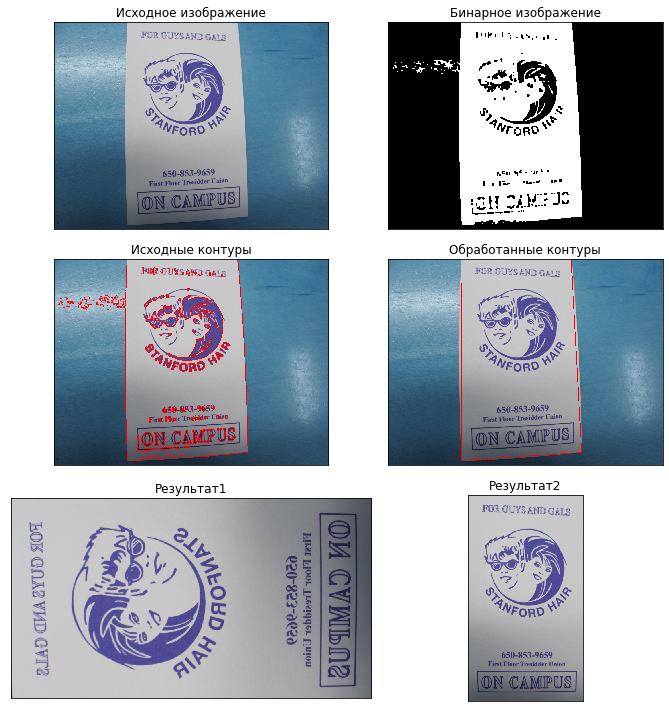

__________________________________________________________________________________


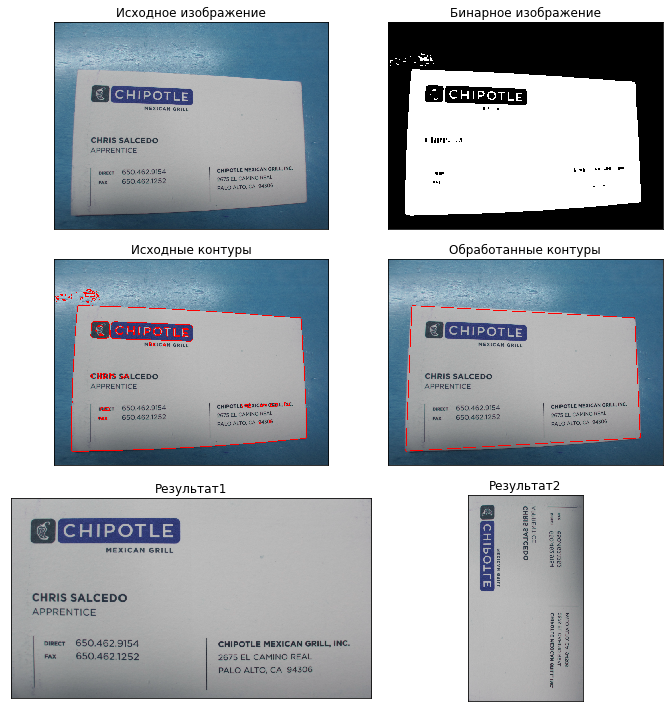

__________________________________________________________________________________


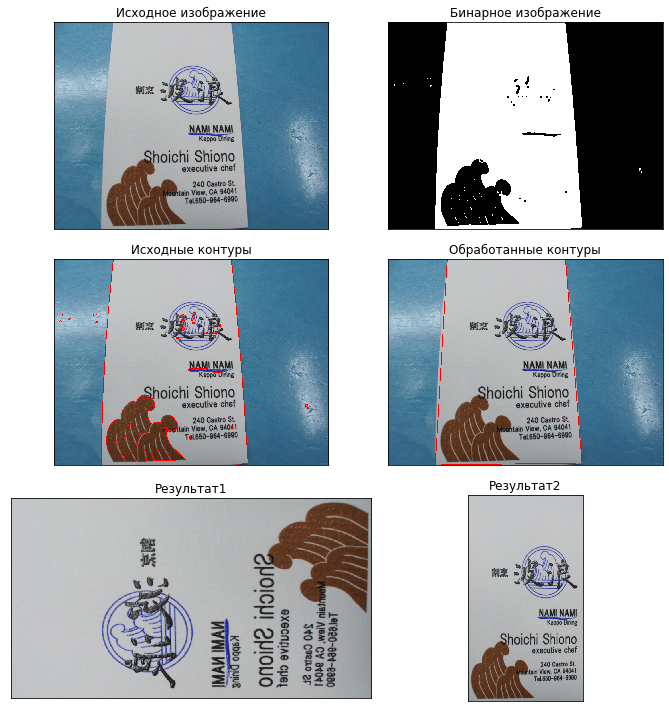

__________________________________________________________________________________


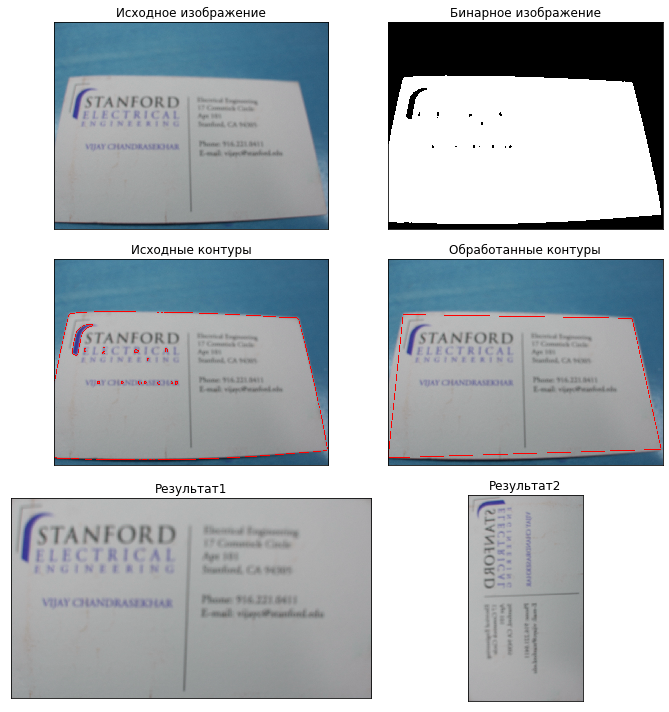

__________________________________________________________________________________


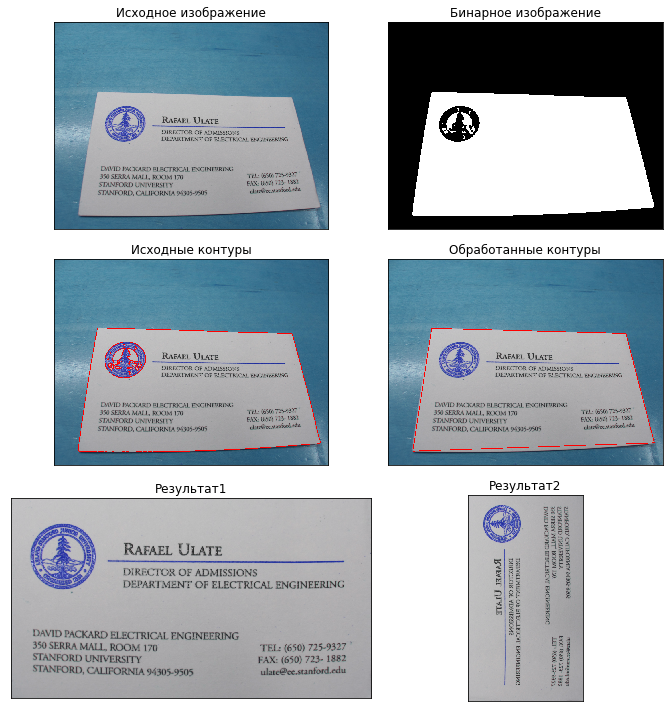

__________________________________________________________________________________


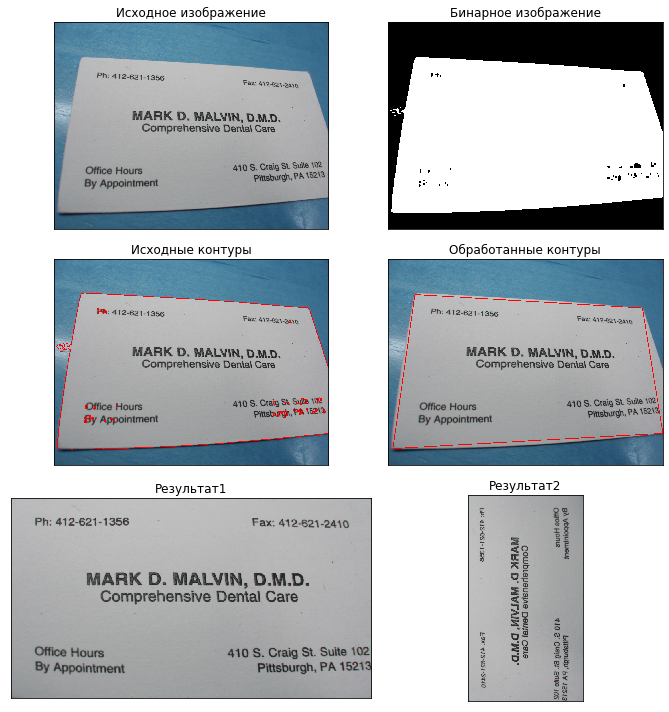

__________________________________________________________________________________


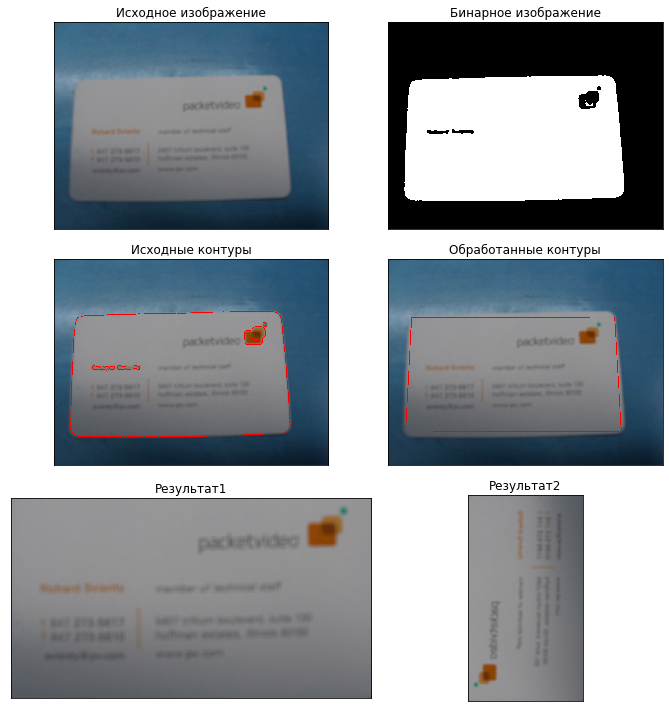

__________________________________________________________________________________


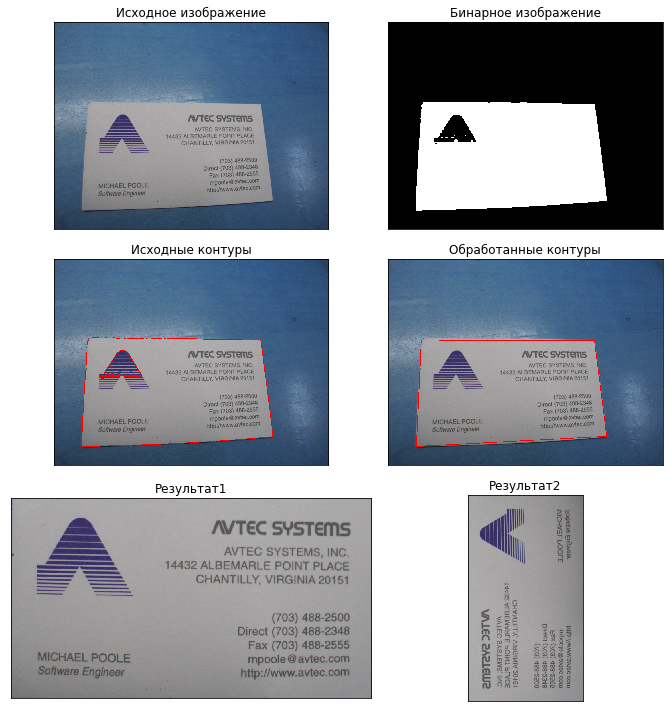

__________________________________________________________________________________


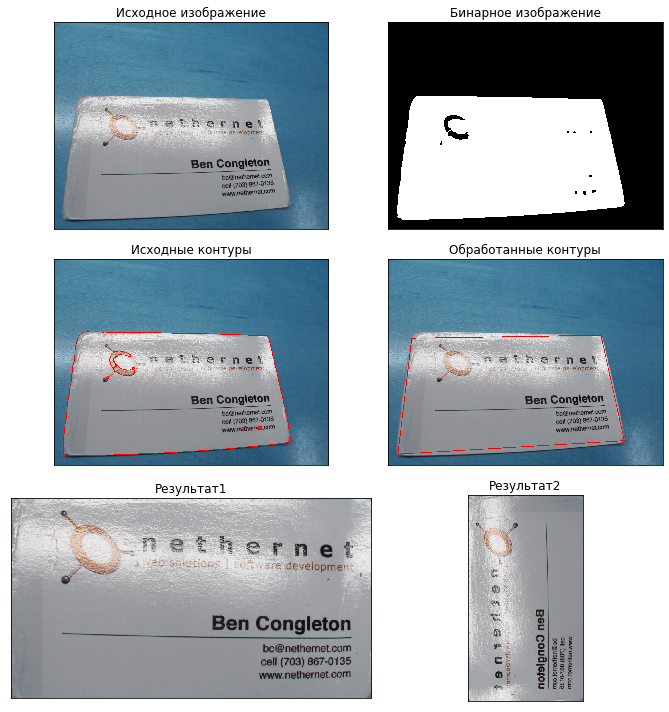

__________________________________________________________________________________


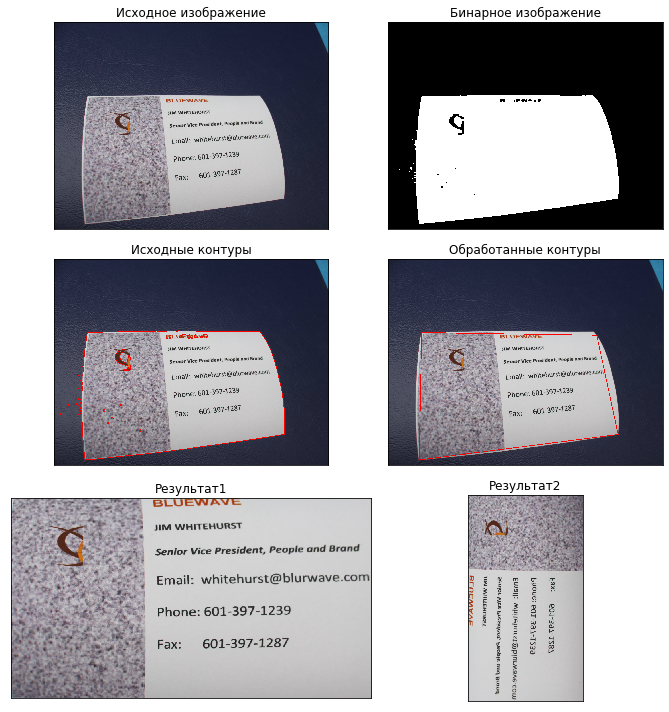

__________________________________________________________________________________


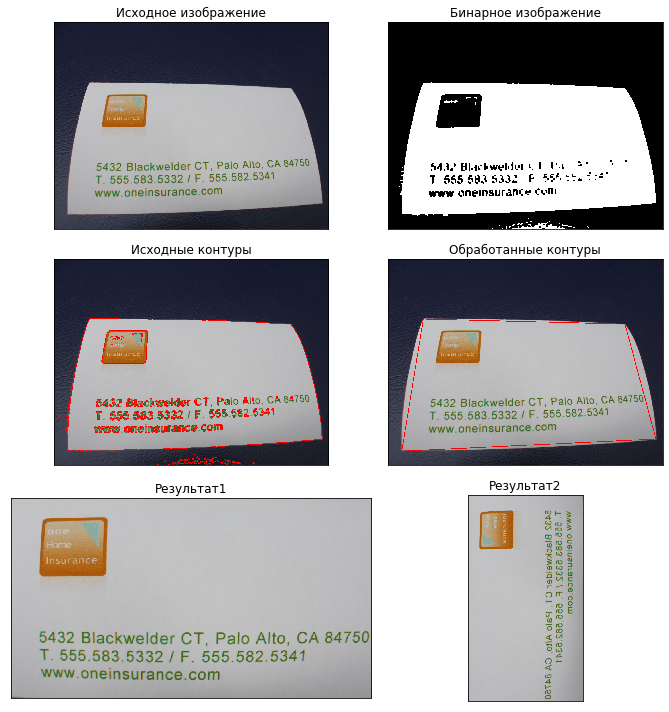

__________________________________________________________________________________


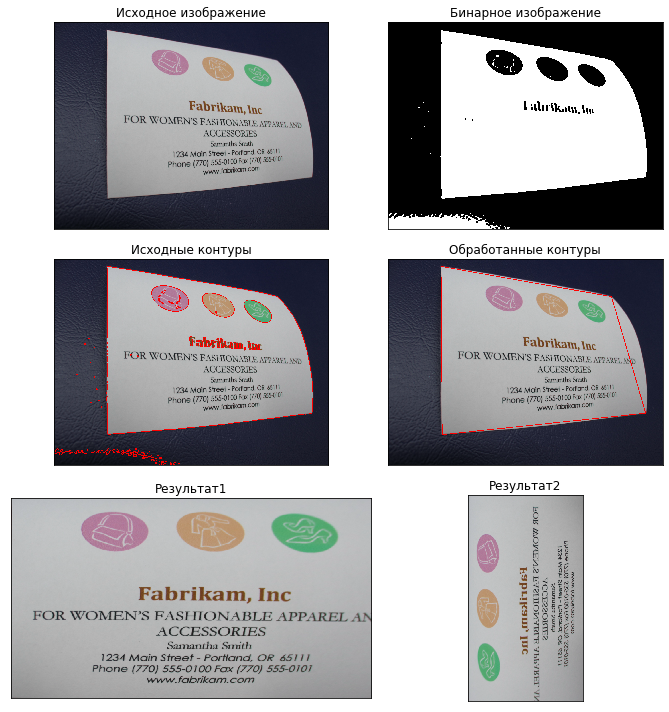

__________________________________________________________________________________


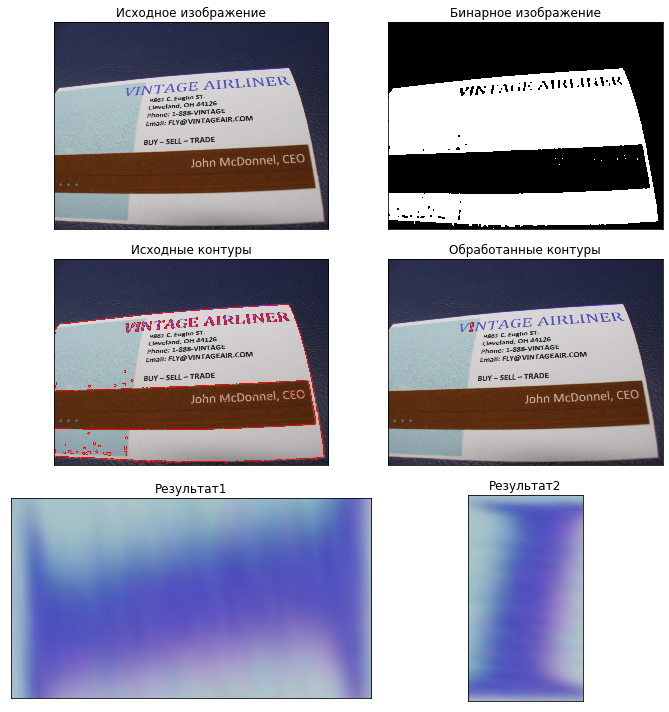

__________________________________________________________________________________


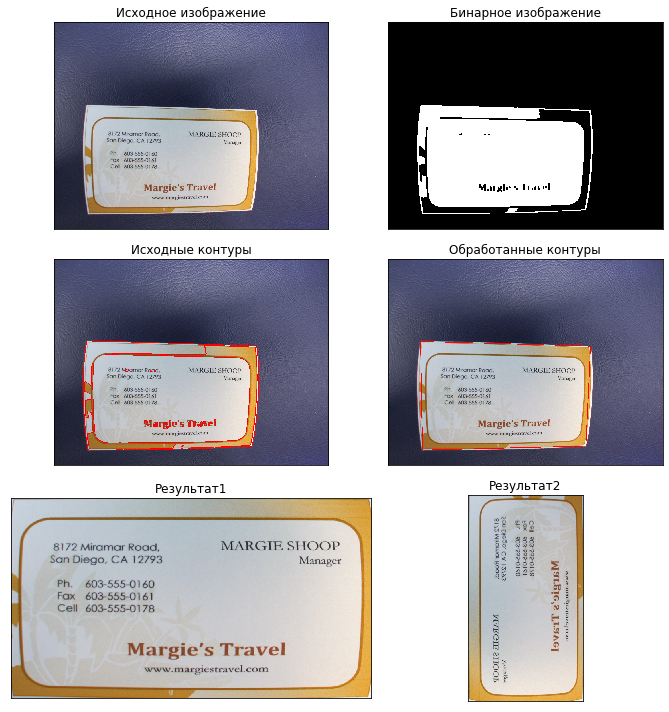

__________________________________________________________________________________


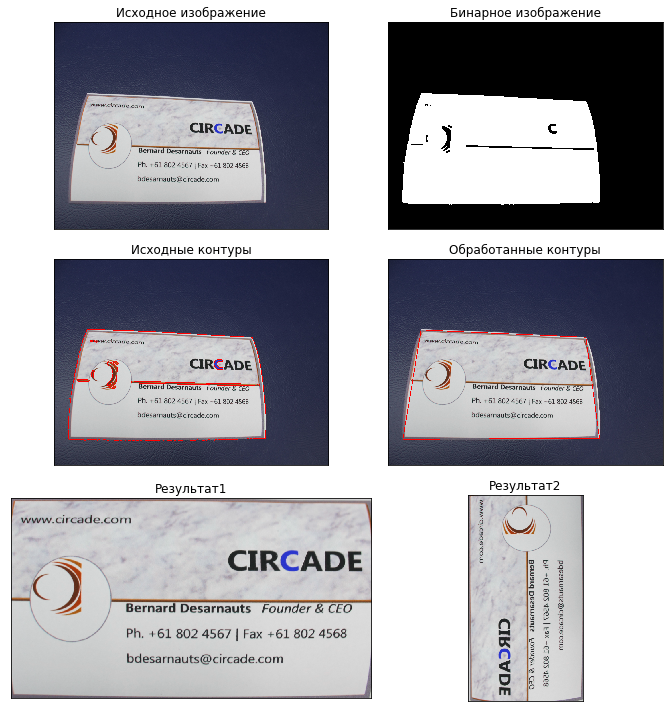

__________________________________________________________________________________


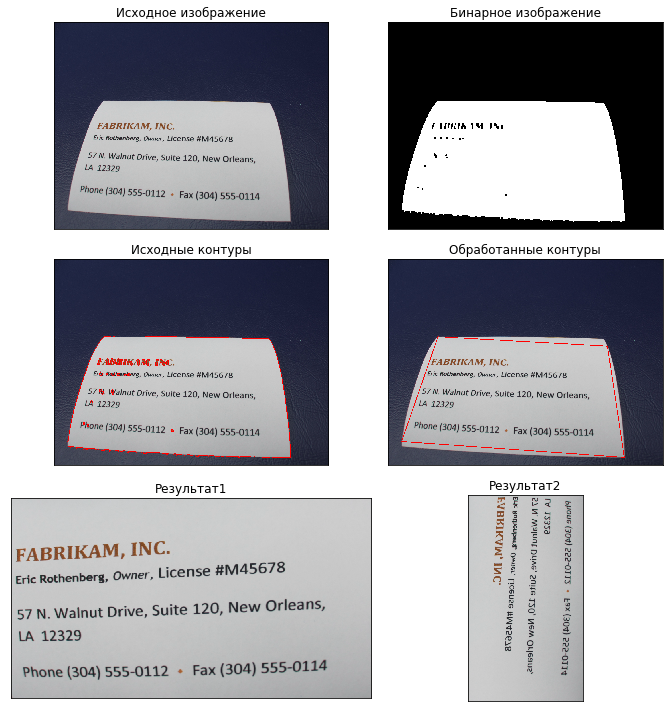

__________________________________________________________________________________


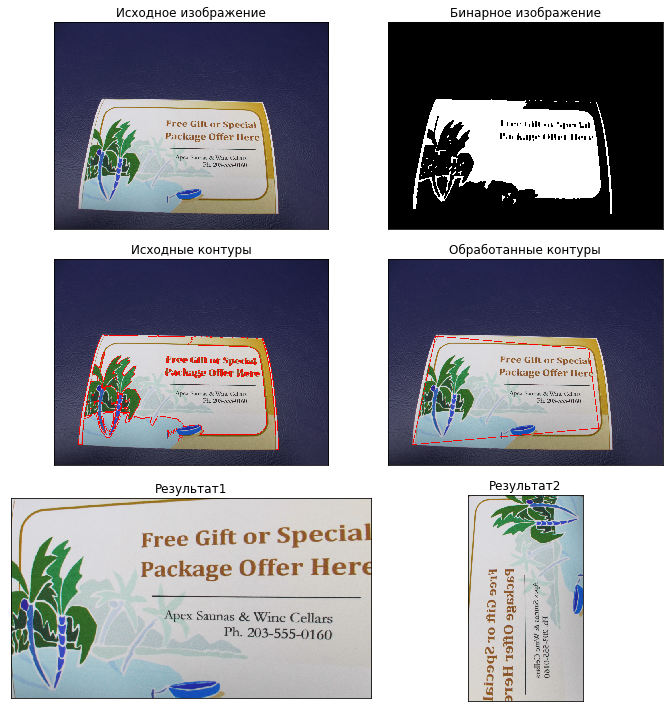

__________________________________________________________________________________


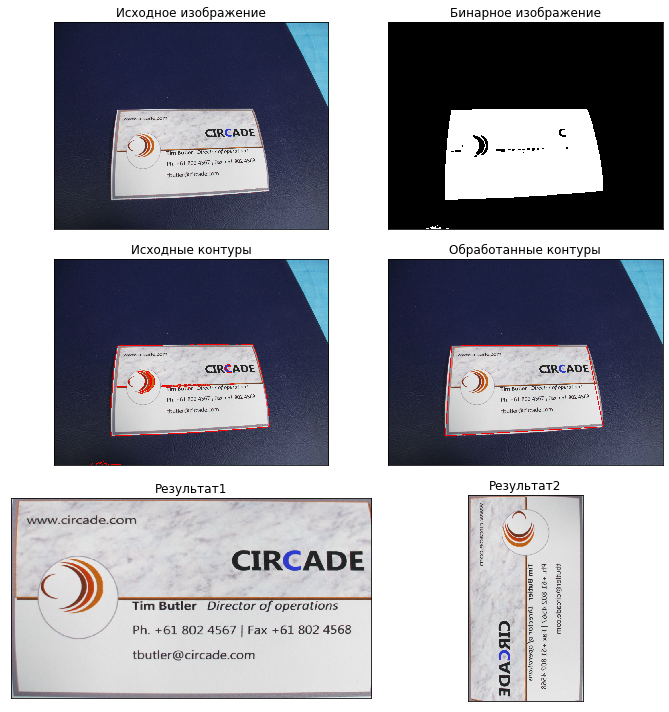

__________________________________________________________________________________


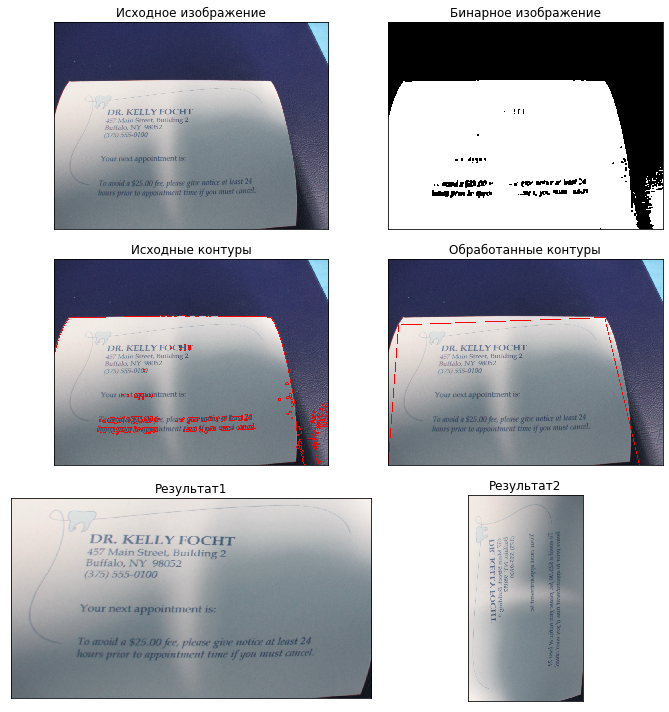

__________________________________________________________________________________


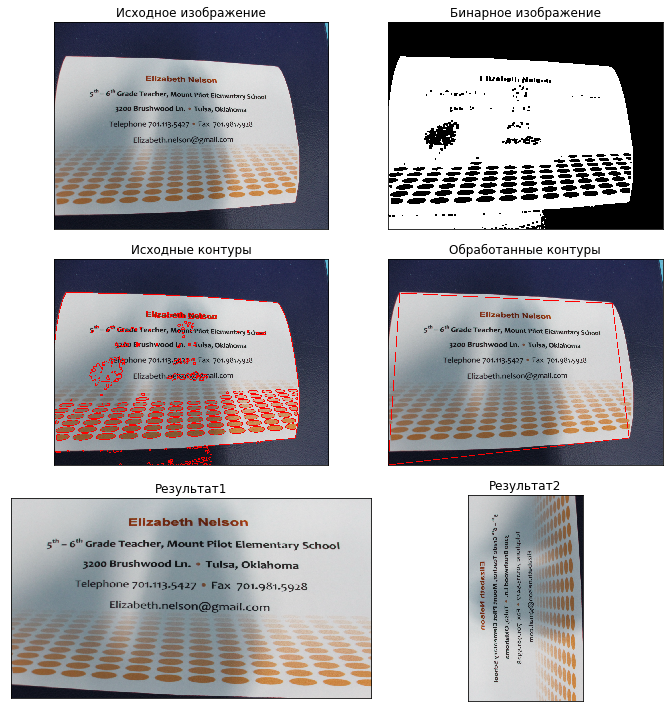

__________________________________________________________________________________


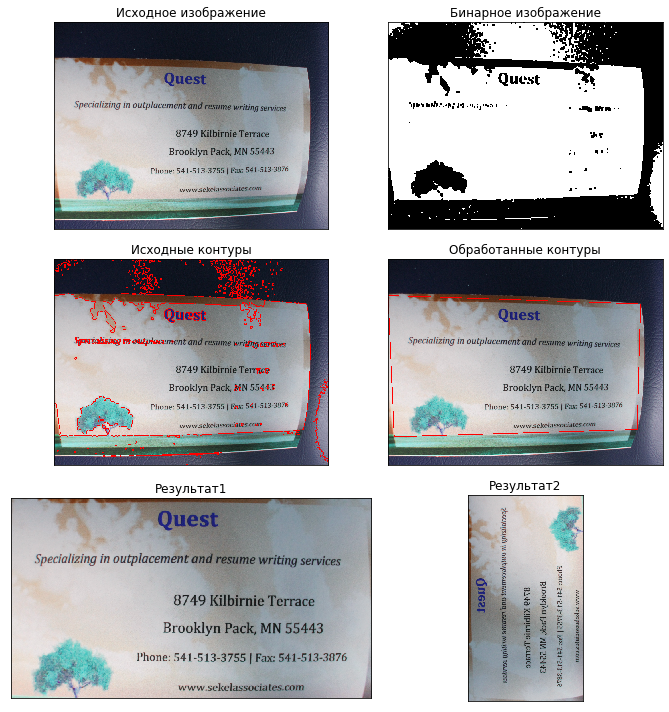

__________________________________________________________________________________


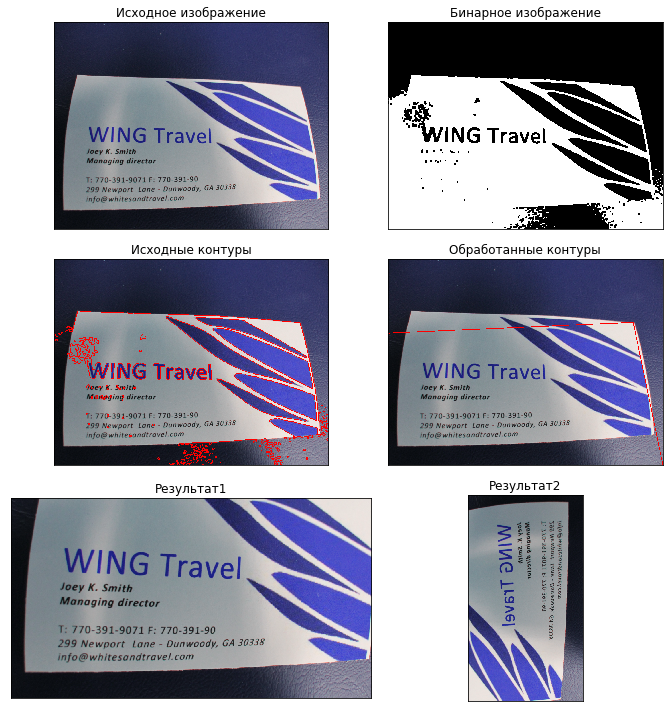

__________________________________________________________________________________


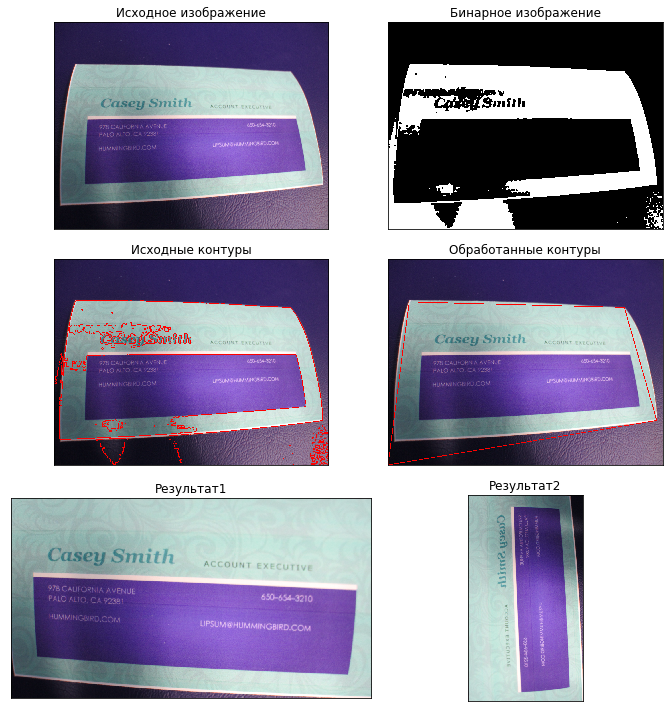

__________________________________________________________________________________


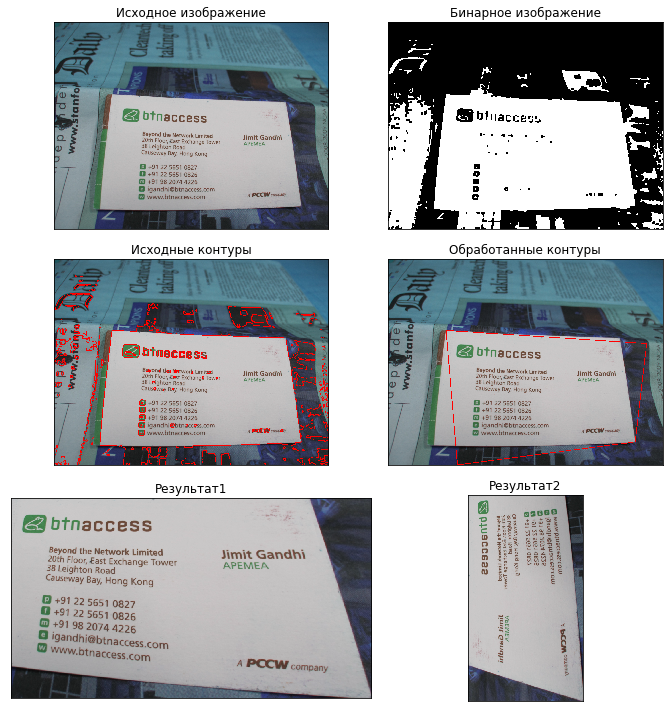

__________________________________________________________________________________


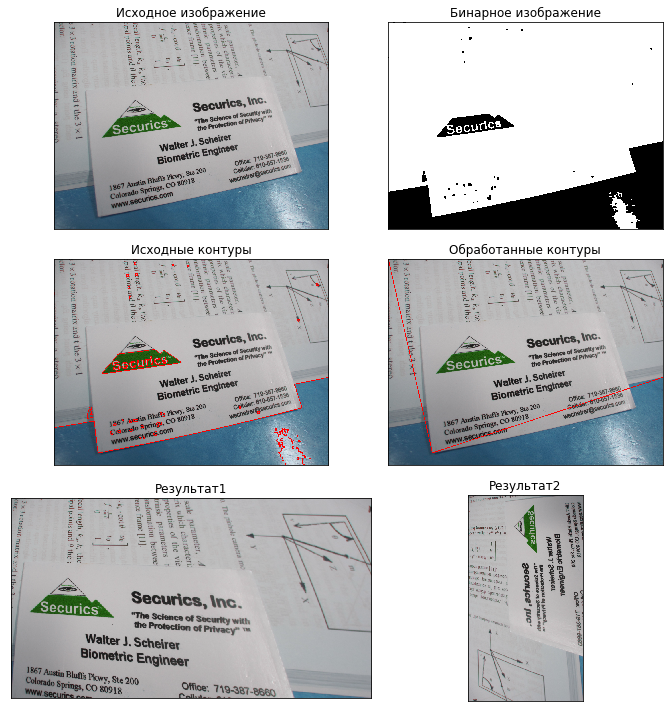

__________________________________________________________________________________


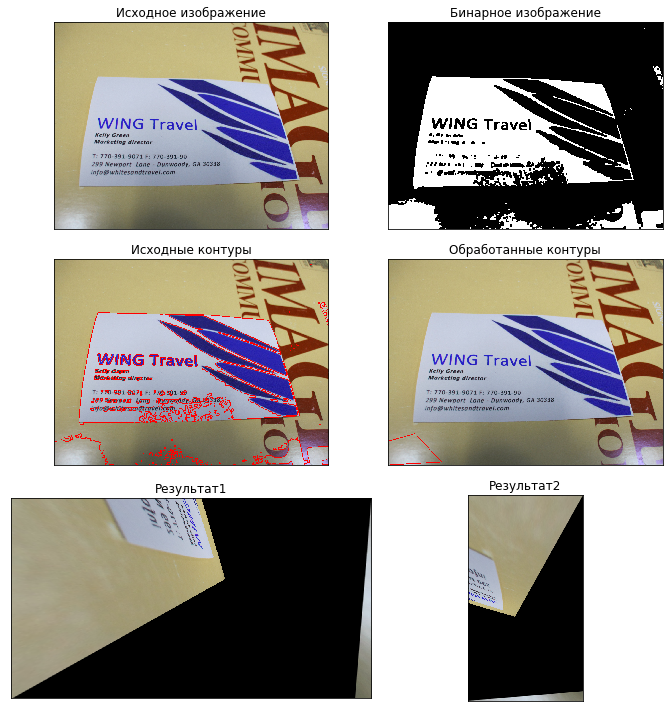

__________________________________________________________________________________


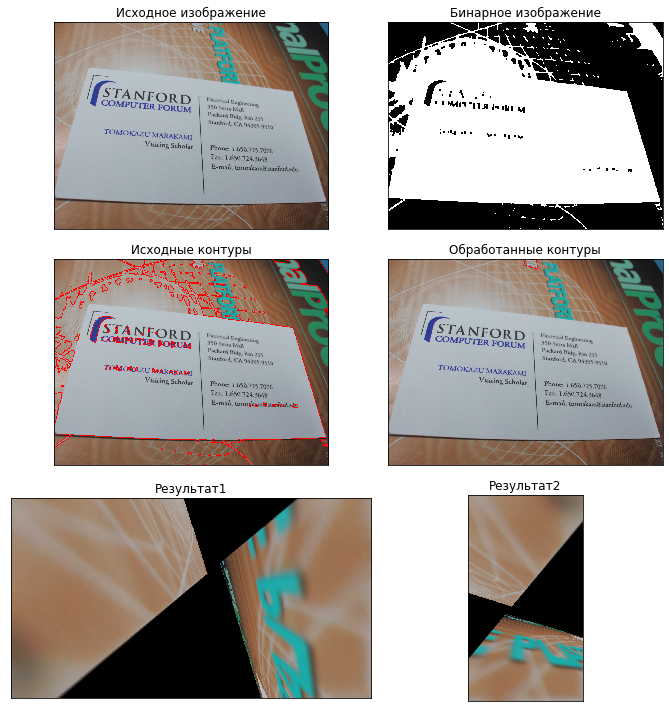

__________________________________________________________________________________


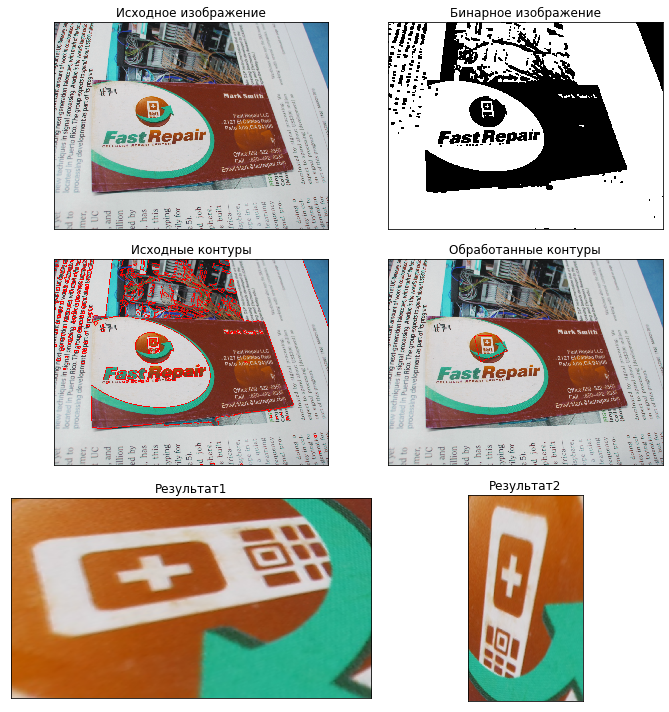

__________________________________________________________________________________


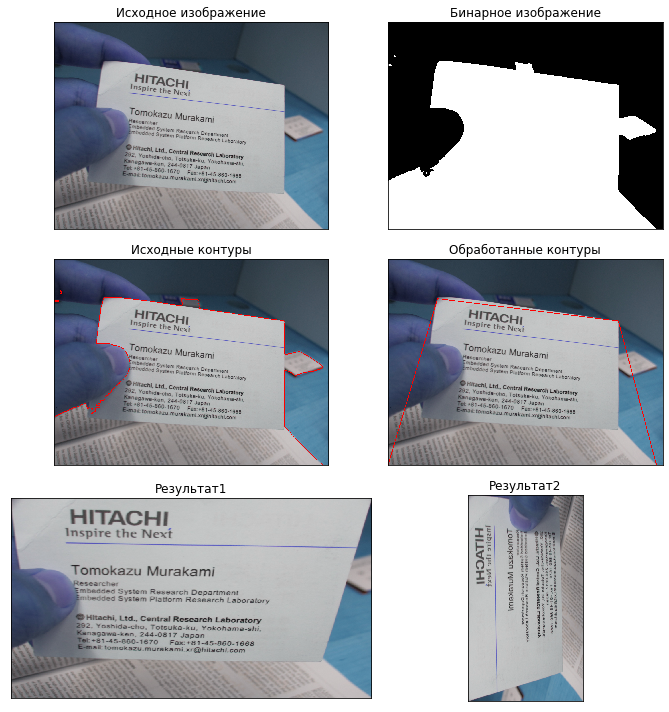

__________________________________________________________________________________


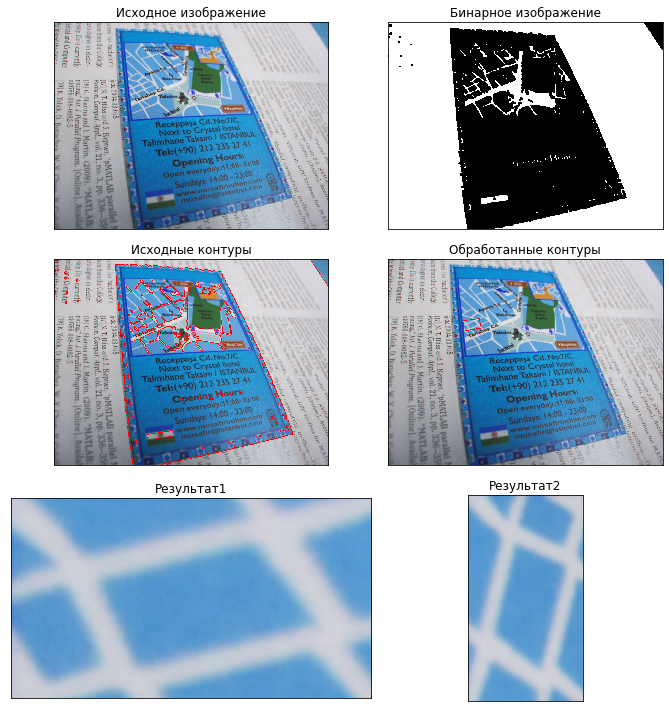

__________________________________________________________________________________


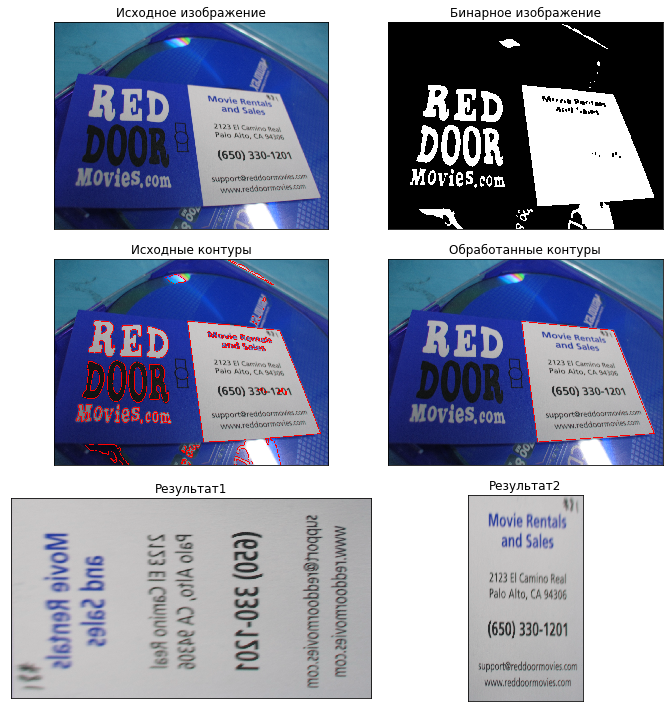

__________________________________________________________________________________


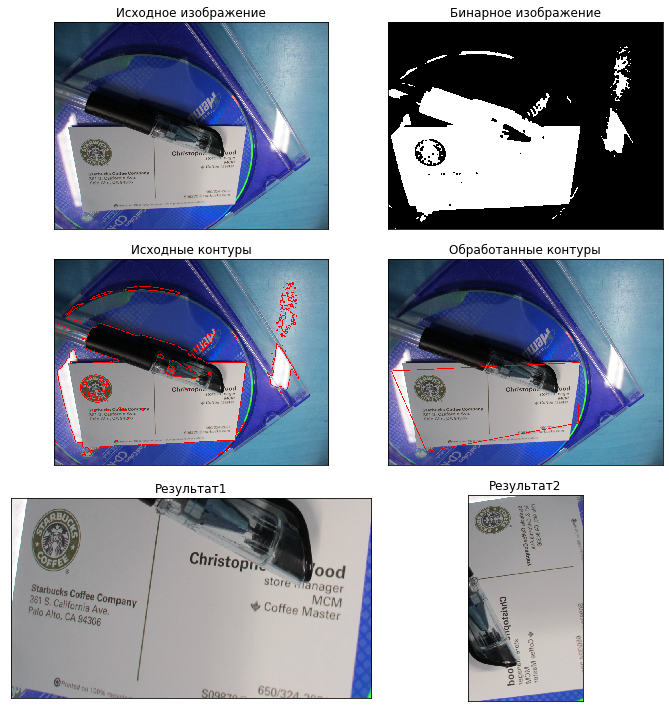

__________________________________________________________________________________


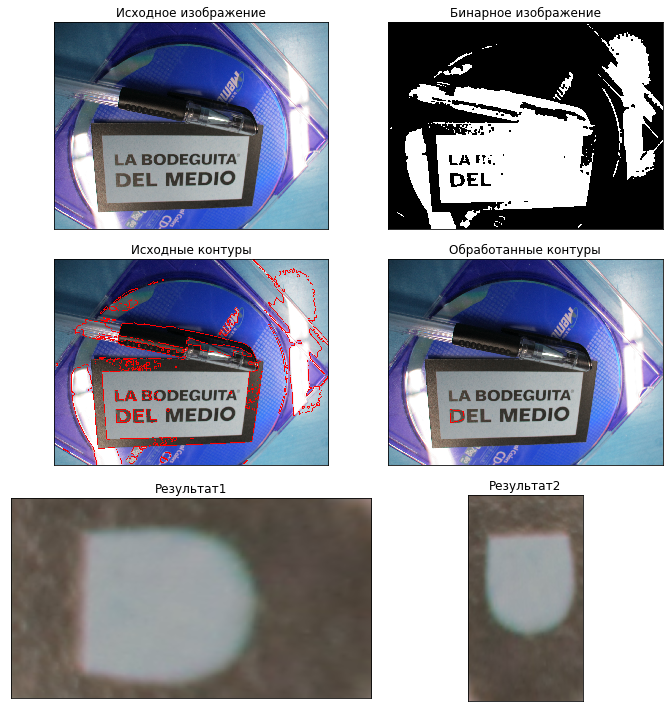

__________________________________________________________________________________


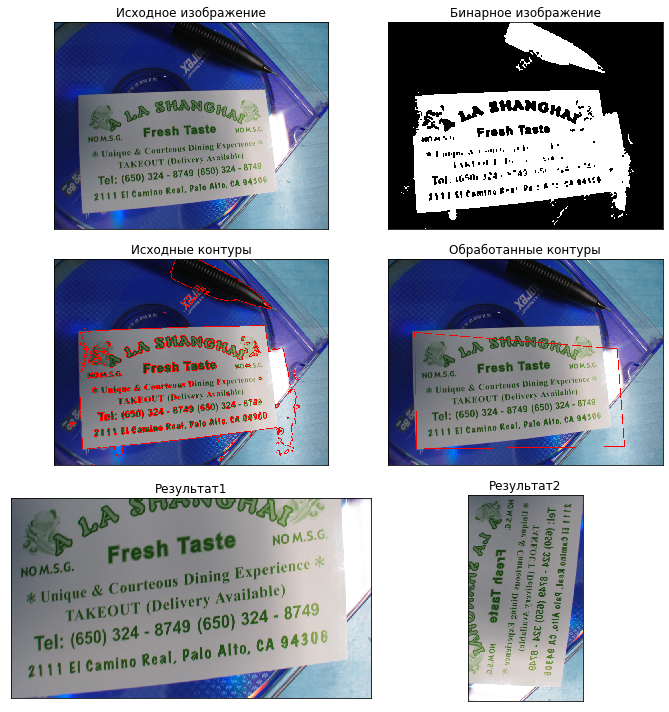

__________________________________________________________________________________


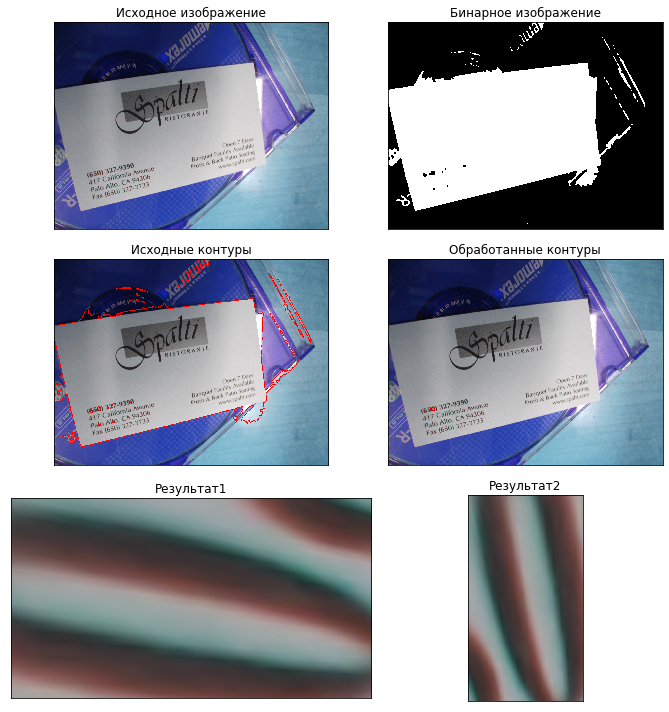

__________________________________________________________________________________


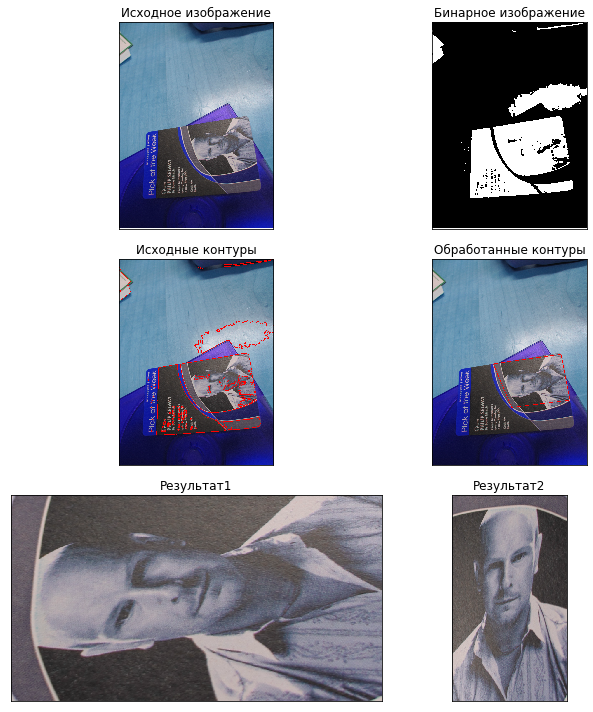

__________________________________________________________________________________


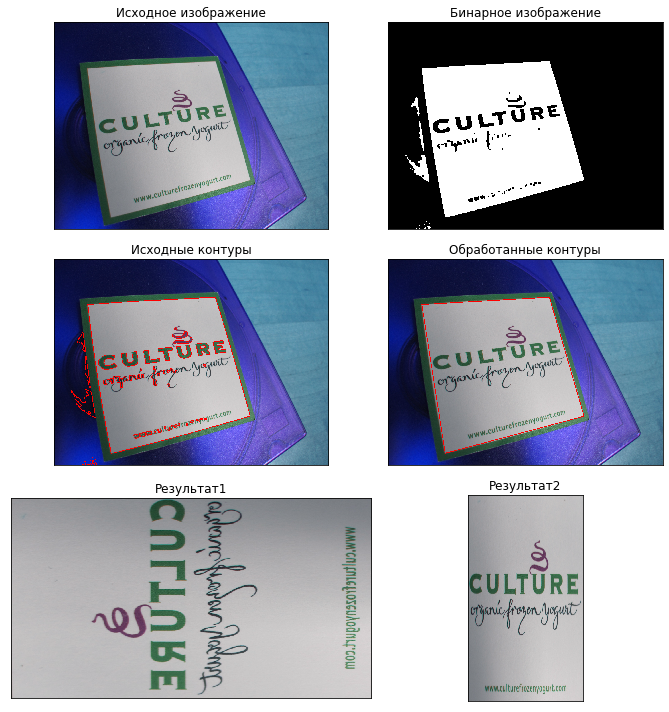

__________________________________________________________________________________


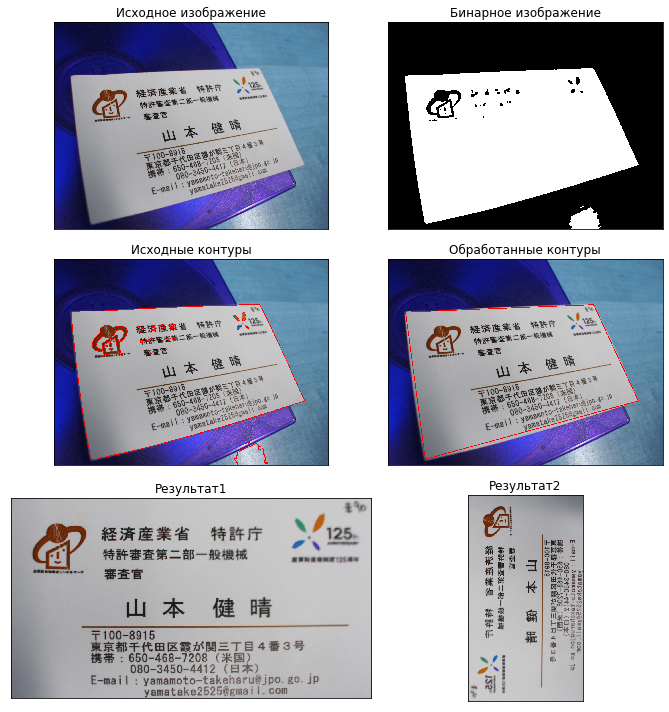

__________________________________________________________________________________


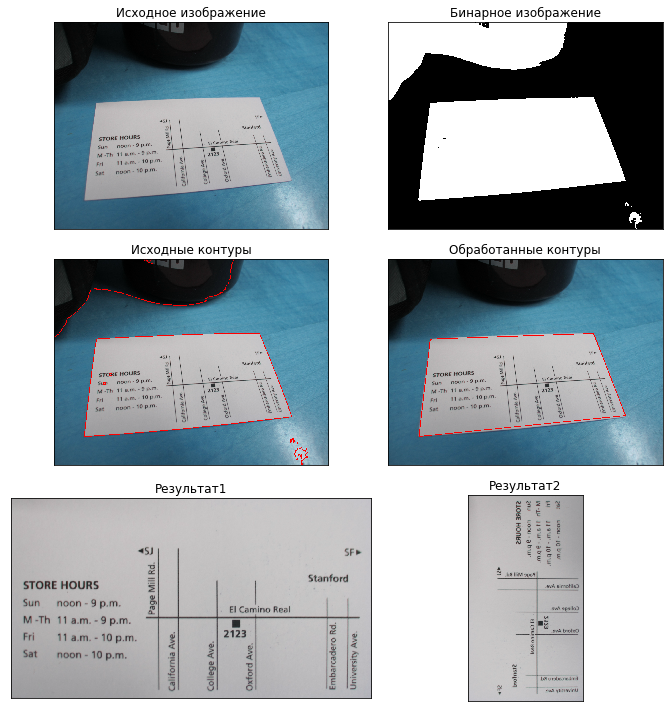

__________________________________________________________________________________


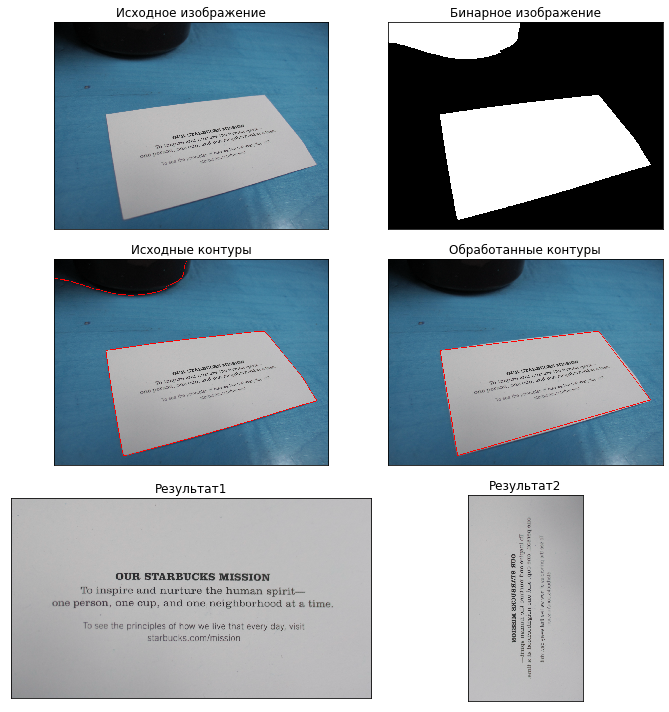

__________________________________________________________________________________


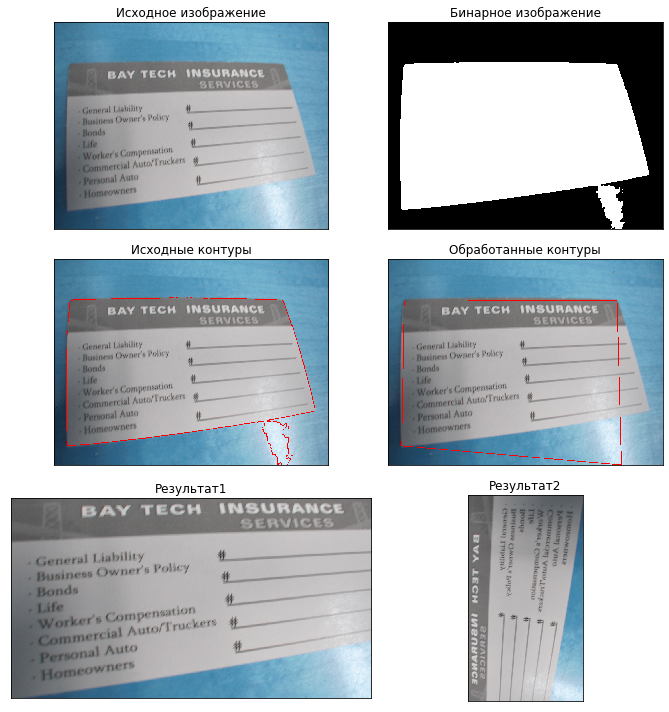

__________________________________________________________________________________


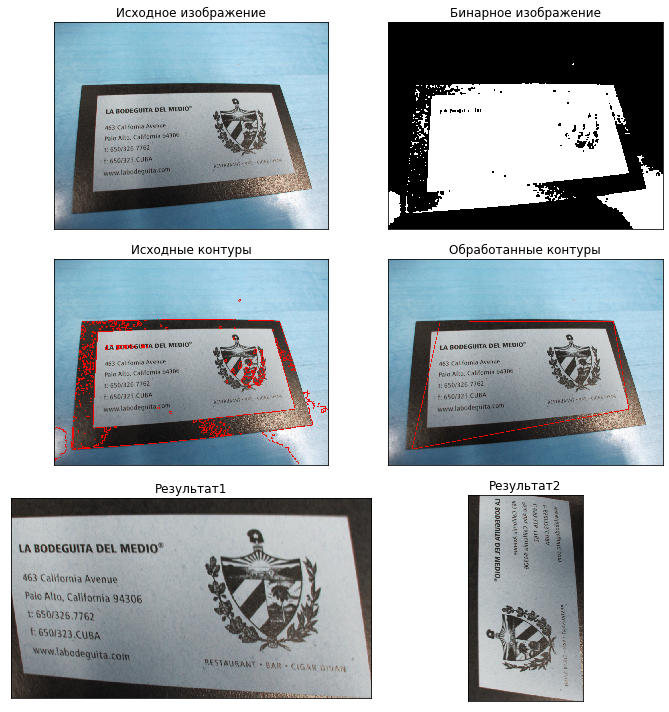

__________________________________________________________________________________


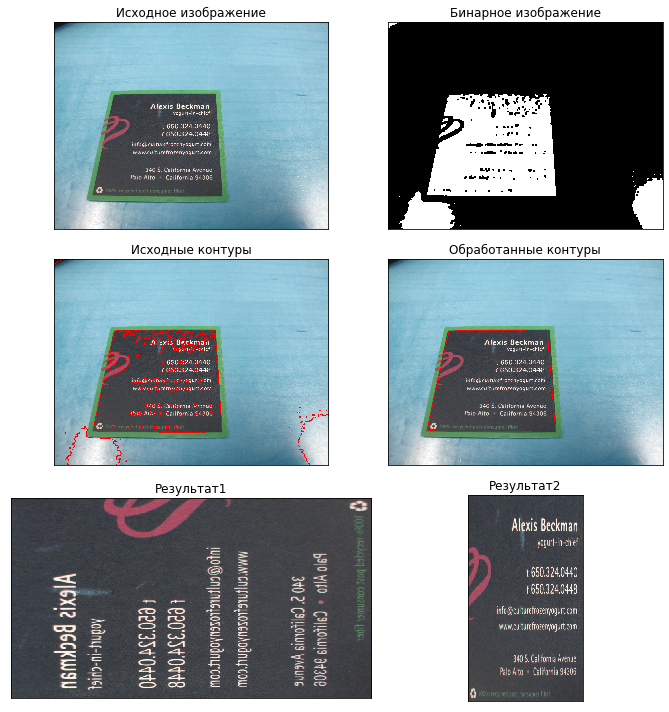

__________________________________________________________________________________


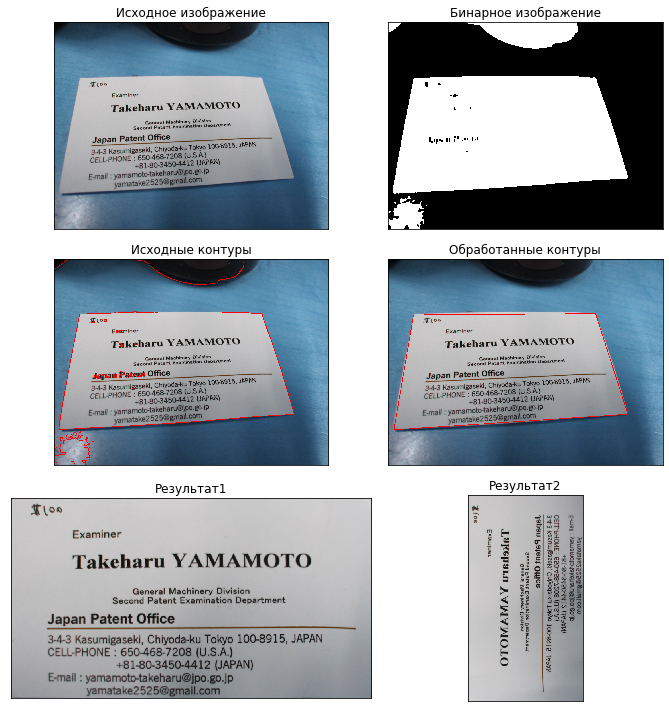

__________________________________________________________________________________


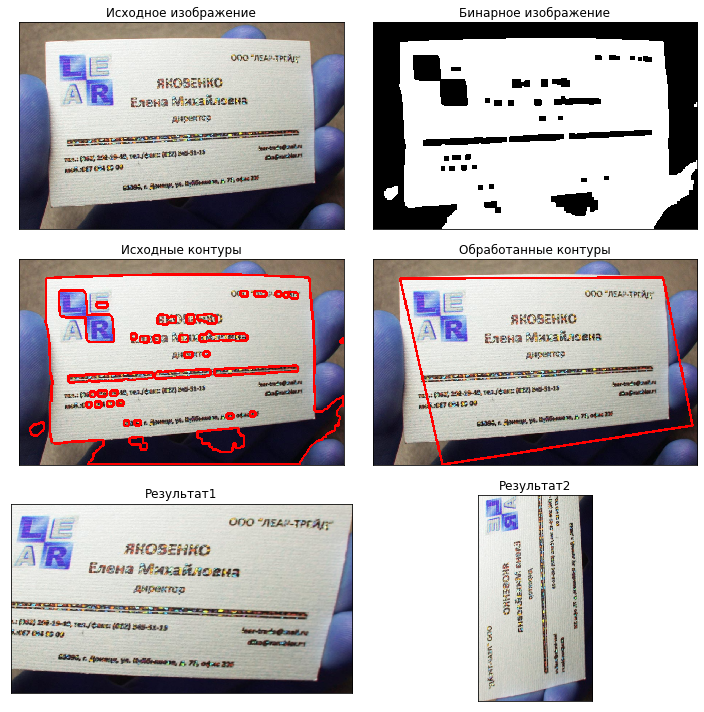

__________________________________________________________________________________


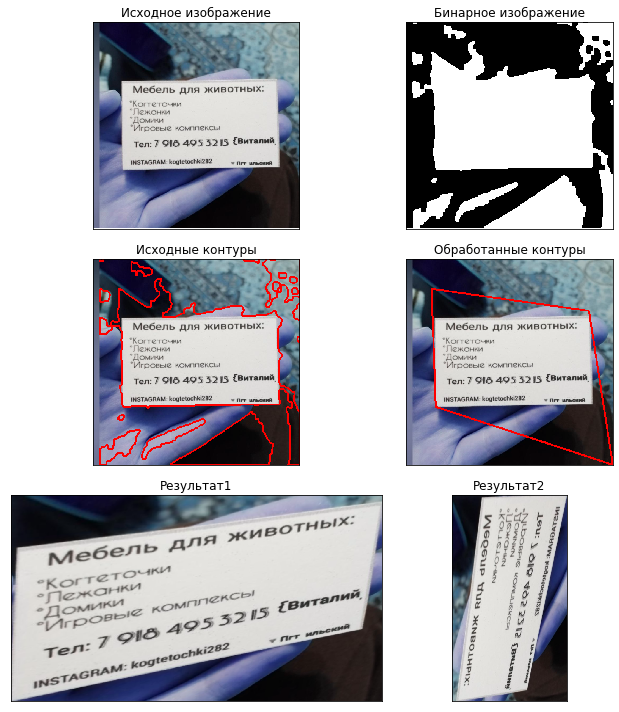

__________________________________________________________________________________


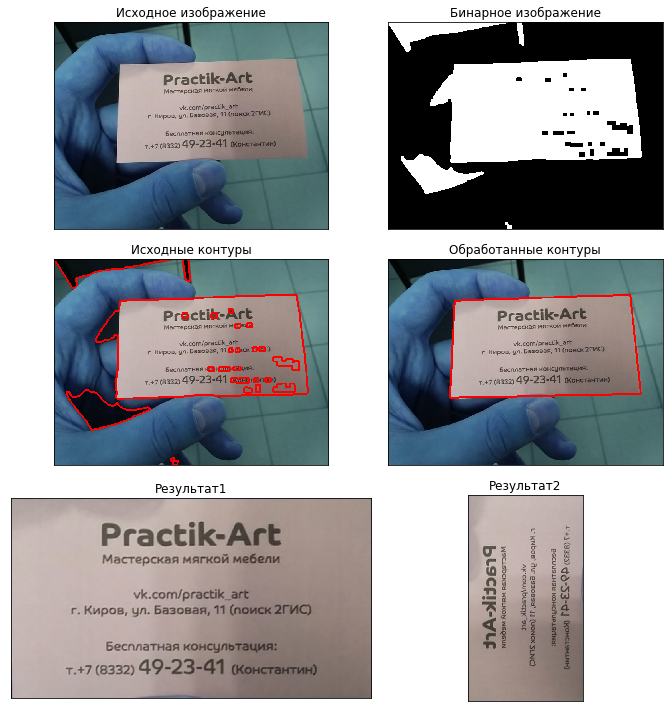

__________________________________________________________________________________


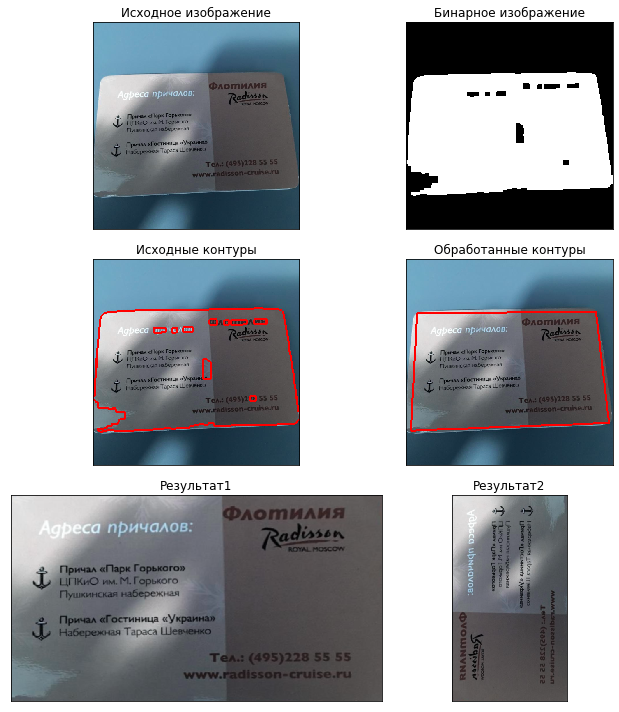

__________________________________________________________________________________


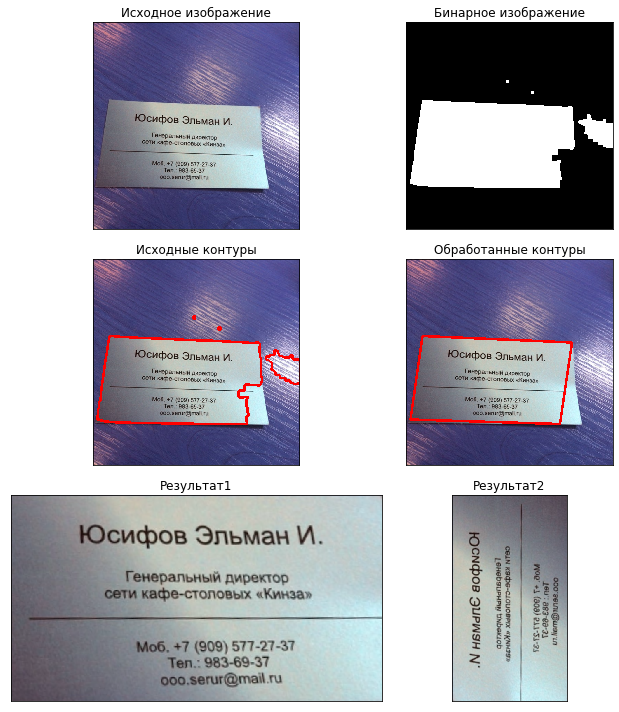

__________________________________________________________________________________


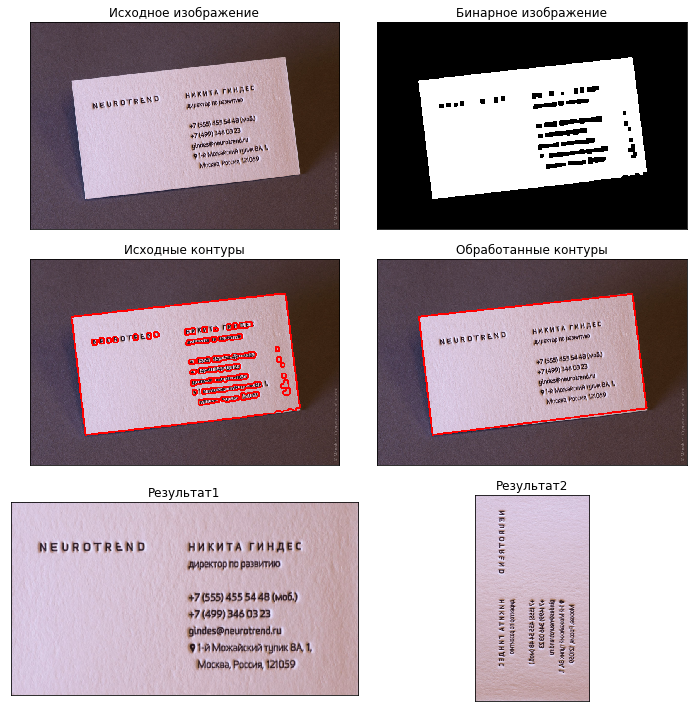

__________________________________________________________________________________


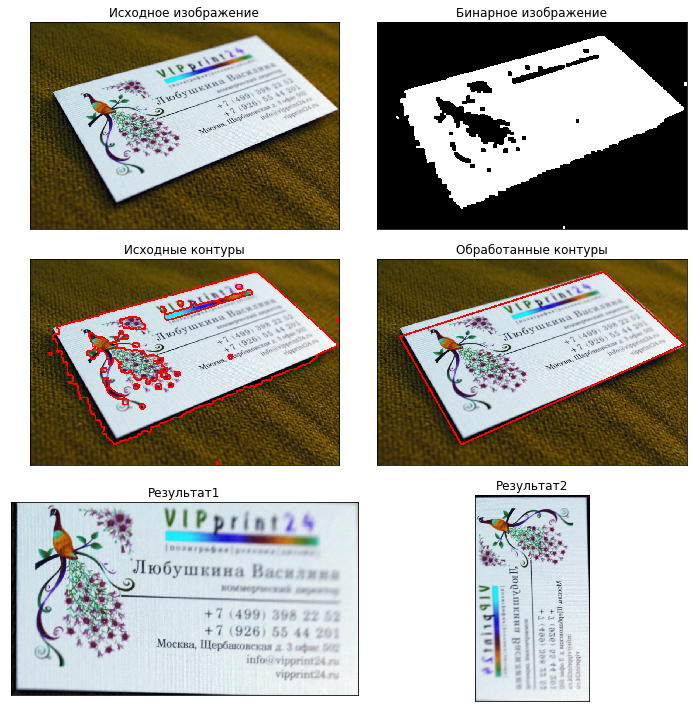

__________________________________________________________________________________


In [5]:
hsv_min = np.array((0, 42 + 3, 20 + 15), np.uint8)
hsv_max = np.array((190+50, 255 - 10, 253), np.uint8)
for fn in images[:]:
 
    ffn = directory + '/'+fn # имя файла, который будем анализировать
    img = cv.imread(ffn)

    if img.shape[0] > 1000:
        scale_percent=50
    else:
        scale_percent=70
    width = int(img.shape[1] * scale_percent / 100)
    height = int(img.shape[0] * scale_percent / 100)
    dsize = (width, height)
    output = cv.resize(img, dsize)
    #blur = cv.bilateralFilter(output,50,10,10)
    blur = output

    hsv = cv.cvtColor(blur, cv.COLOR_BGR2HSV) # меняем цветовую модель с BGR на HSV

    thresh4 = cv.inRange(hsv, hsv_min, hsv_max ) # применяем цветовой фильтр
    
    kernel = np.ones((5,5),np.uint8)
    thresh4 = cv.morphologyEx(thresh4, cv.MORPH_CLOSE, kernel, iterations = 1)
    thresh4 = cv.morphologyEx(thresh4, cv.MORPH_OPEN, kernel, iterations = 2)
    _,thresh4 = cv.threshold(thresh4, 0, 255, cv.THRESH_BINARY_INV)   

    contours, hierarchy = cv.findContours(thresh4.copy(), cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
    imageWithContours = cv.drawContours(output.copy(), contours, -1, (255, 0, 0), 3)
   
        
    businessCardContour = SearchOfCard(contours)
    if businessCardContour == None:
        continue
    
    imageWithBusinessContours = cv.drawContours(output.copy(), businessCardContour, -1, (255, 0, 0), 3)
    
    cnt = sortPoints(businessCardContour[0])
    #print(len(cnt),len(cnt[0]),len(cnt[1]))
    pts1 = np.float32(cnt[0])
    pts2 = np.float32([[0,0],[900,0],[0,500],[900, 500]])
    M = cv.getPerspectiveTransform(pts1, pts2)
    dst1 = cv.warpPerspective(output, M, (900,500))
    cv.imwrite(result + '\\' + fn[:-4] + 'Hor.png', dst1)
    
    pts1 = np.float32(cnt[1])
    pts2 = np.float32([[0,0],[500,0],[0,900],[500, 900]])
    M = cv.getPerspectiveTransform(pts1, pts2)
    dst2 = cv.warpPerspective(output, M, (500,900))
    cv.imwrite(result + '\\' + fn[:-4] + 'Vert.png', dst2)

#for show
    grid = [[output,'Исходное изображение'],
        [thresh4,'Бинарное изображение'],
        [imageWithContours,'Исходные контуры'],
        [imageWithBusinessContours,'Обработанные контуры'],
        [dst1,'Результат1'],
        [dst2,'Результат2']]

    fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(10, 10,),
                        subplot_kw={'xticks': [], 'yticks': []})

    for ax,graf in zip(axs.flat, grid):
        ax.imshow(graf[0], interpolation=None, cmap='gray')
        ax.set_title(str(graf[1]))

    plt.tight_layout()
    plt.show()
    print('__________________________________________________________________________________')

In [6]:
directory = result
files = os.listdir(directory)
images = filter(lambda x: x.endswith('.png'), files)
images = list(images)

# Предобработка

# Распознование

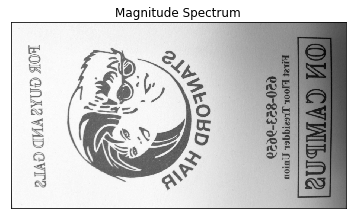

OU CVNbNa

Julhzg POOL TLeziqqe. uiou

020-823-0020

 

LO’ GNA2VUD Cvre


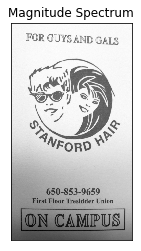

FOR GUYS AND GALS |

 

650-853-9659

First Floor Tresidder Union ~

ON CAMPUS


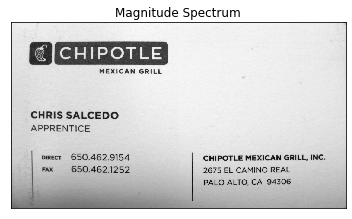

CHRIS SALCEDO _
“APPRENTICE . 7

ommect” 650.462.9154 CHIPOTLE MEXICAN GRILL, INC.
: Fax 650.462.1252 2675 EL CAMINO REAL
, " PALO ALTO, CA 94306


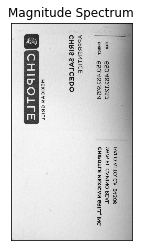

Le oo _ BvTO WIL0’ Cy adie
“ahd ex” epowesIS25 Se2 EP CVWIMO BEWr

 

pIECL, EDO'TES'!2T CHIDOLFE WEXICVH BI Mc
_-WbbBEULICE ; : -

[ CHBI2 2VrCEDO

WEXICWH CBITT


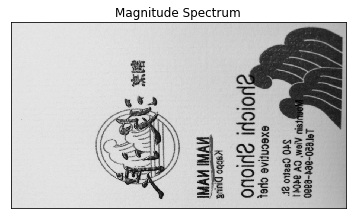

AN if L&/e20-ae¢-e990
Uy MIFST ALOM' CY atO¢]
H/A oe S40 CI2HO oF

AXCNTIAG CUEL

L! ablouo


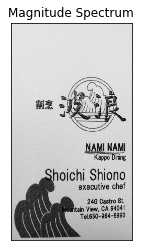

"NAMI NAMI
. Kappo Dining

Shoichi Shiono

executive chef

  
   
 

ap 240 Castro St.
whtain View, CA 94041
Tel.650-964-6990


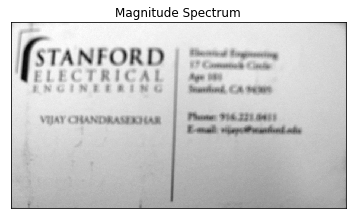

STANFORD
ELECTRICAL

PWadw ss hg tese

VAY CALAN D RAG hha

acit,

Beertied egreesneiong
EAE cereeetinn dh # ise tae
Fon tue

Tepes, Ok deca?

Bren DEC SIE ere
Bosse epee Pre csttionh alee


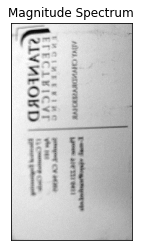

eee eee a a meiteoae eye
Har ate Ses ate

oF

 

pehegeed @ Se Pay
aSe res
By a Tete Tenge

qqeemerty quebeenarel


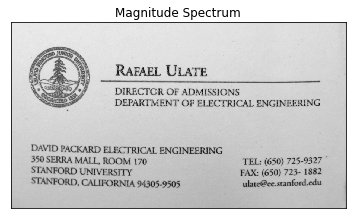

RAFAEL ULATE

DIRECTOR OF ADMISSIONS
_DEPARTMENT OF ELECTRICAL L ENGINEERING

 

 

DAVID PACKARD ELECTRICAL ENGINEERING

350 SERRA MALL, ROOM 170” “TEL: (650) 725-9327 *

STANFORD UNIVERSITY FAX: (650) 723- 1882
STANFORD, CALIFORNIA 94305-! 9505, : ulate@ee.stanford.edu


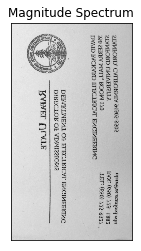

2INVIEOKD" CymLOMIV T3202" a0 : HIMC@cereesupouqeqn

2IVMEOBD NUIAEWELLA EVX: (020) A32- rgey -

220 2EKBY WVIT BOOW INO. , LET? (020) A32-935\, ,
DVAID LYCKVED ETECLBICWT EACIMEEBING ue ey :

: " DEBVSLWEUL Ok ETECLKICWT T EMCIMEEMING .
" DIBECLOY OL VDWIe2ione

BVEVET QIVLE


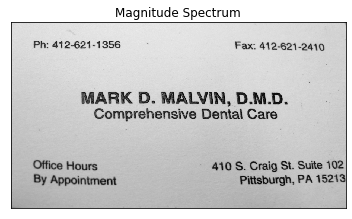

eS

Ph: 412-621-1356 = Fax: 412-621-2410

MARK D. MALVIN, D.M.D. ,
Comprehensive Dental Care

Office Hours + 440 S. Craig St. Suite 102
By Appointment Pittsburgh, PA 15213


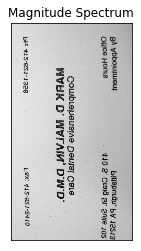

BA ybhbolujweut " piepmay' By 12513
olce Home . t0 2° cls18 er enue Jos

_cowbiepeveine peuis] csie
NYE D'INWTAIA DD" |


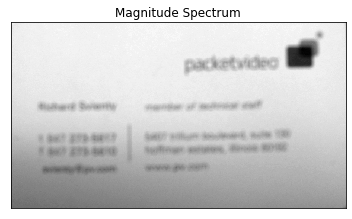

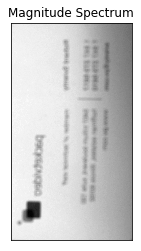

bie, hott noes
Be ee bee ey
sree Bos tangs
wee ey


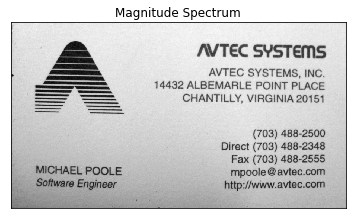

AVTEC SYSTEMS

AVTEC SYSTEMS, INC.
14432 ALBEMARLE POINT PLACE

CHANTILLY, VIRGINIA 20151

i
we

(703) 488-2500
Direct (703) 488-2348
Fax (703) 488-2555
MICHAEL POOLE
Software Engineer

mpoole @avtec.com
: http:/Avww.avtec.com


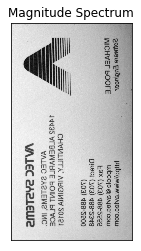

QoyNsis EUdUGEL
WICHVEr bOOreE

a(t!
qi,

| BUDA sAec'cous
Wwhoojs @ svfec’cow
ESX (403) ¥88-Se22

Ditecs (403) ¥8e-Save
(\03) 188-5200

CHYULITTA AIBGIUIY S012!

INY3S VWIBEWVETE bOIML bFVCE
VALEC @A@LEW2' INC’

VALEC ede leWe


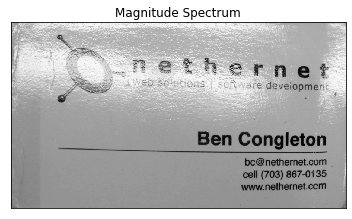

Ben Congleton

*. be@nethernet.com |
cell (703) 867-0135
www.nethernet.com

    

|

df


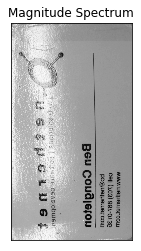

MWucuBlpelwercou
cell (\03) 8e4-0132

_ PCGuSPEWwercow .

 

B6U Coudefou


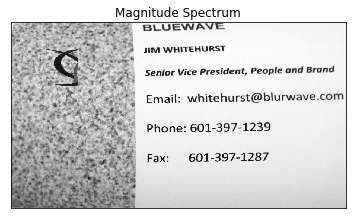

BLUEWAVE

JIM WHITERURST

Senior Vice President, People and Brand
Email: whitehurst@blurwave.com
Phone: 601-397-1239

Fax: . 601-397-1287


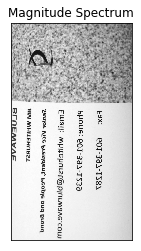

ESX: = @OT-30\-TS8\
bYOUG: EOT-30\-T530
EWSI|: MPIFEUNL2E@pinumgae-cow

26U10L AIC bisziqeur _Eobjs aug giauq

IW MHLLEHNBeL

 

BONEAMVAE


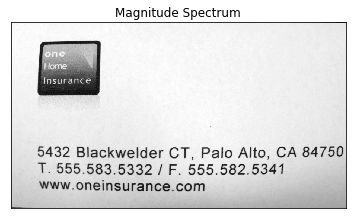

5432 Blackwelder CT, Palo Alto, CA 84750
T. 555.583.5332 / F. 555.582.5341
www.oneinsurance.com


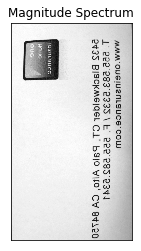

MMM OUGIVeNLSUCG’ COU)

1 222°283'2335 \E Pee PBS Vat4

2¥35 BISCKMEIGEL CL’ bSIO YIfo

 

CV 8YA20


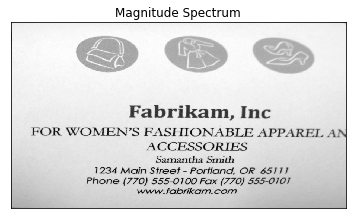

QS >

Fabrikam, Inc

FOR WOMEN’S FASHIONABLE APPAREL AN
ACCESSORIES
Samantha Smith
1234 Main Street - Portland, OR 65111

Phone (770) 555-0100 Fax (770) 555-0101
www.fabrikam.com


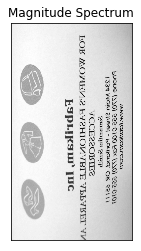

AAMAVLODUKOM COU
bKOUG (\X0) 222-0100 LOX (rn0) 222-0101
ISBY WAI VUSS} - pOUNGUG’ O% W111
eSWITUTPT SUT
YCCE22e0sike
LOB MOVE. EVCHIOUVEBLTE VbbYKED VV

ELSPLIPSNS poc


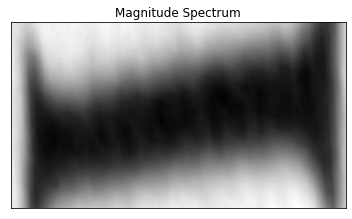

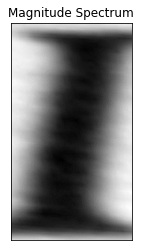

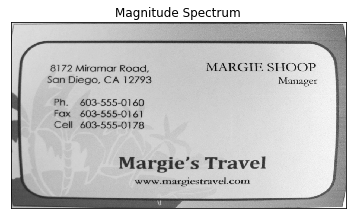

8172 Miramar Road,
‘San Diego, CA 12793

“Ph, 803-555-01 60
’Fax 603-555-0161

Cell 603-555-0178 . .
abe os

MARGIE SHOOP.

Manager


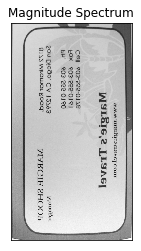

Cannan warBbicssacy cous

| > INSLETE, 2 LLSAG]

EPS ns
7 Cel 203-222-0148 * °

SKOX 903-222-0121
“bE § 903-222-0190

- 2aU DISsAo" CY 15\33 - yisusBer
BIAS Whaat Boa’ WVEKCIE 2HOOB


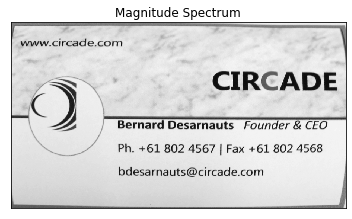

We at o ~ as
Bem Be
te

“www.circade.com * ” ET “ - SO atte
o ott ot va
wpe wee i oa
PRR _CIREADE
. a beg
& a

   
 

  
 
 

Bernard Desarnauts Founder & CEO
Ph. +61 802 4567 | Fax +61 802 4568

bdesarnauts@circade.com


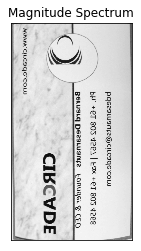

pqsees.usnse@cucsqe'cow

bb" +@T 805 W2e\ | E9X +ET 805 Y2e8

BGELUSLq peesiuange LONUGSL S CEO

    
      

“MMM’CILCSQ6’COLU "5
—. ~

Dew oe


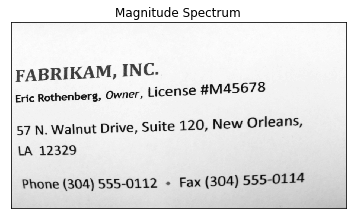

FABRIKAM, INC..
Eric Rothenberg, Owner, License #M45678

57 N. Walnut Drive, Suite 120, New Orleans,
LA 12329 7

Phone (304) 555-0112 + Fax (304) 555-0114


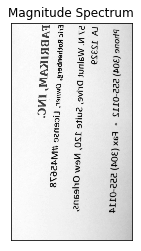

bUOUG (304) 222-OTIS + ESX (30) 222-0TT¢

V I5350 -.
2A UW" MSIUNE DLtAG* enige T5Q° NSM Ollssue*
ElIc KOfveUpeLa’ QmMusL?

CGN HIW2E\g
EVBBIKVIA’ IMC"


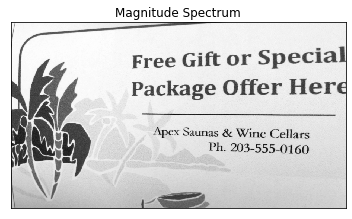

Free Gift or Special
Package Offer Here

rex Saunas & Wine Cellars: .
<2 Ph. 203-555-0160


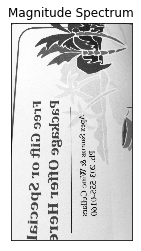

‘pycKsBe OSL H6xe
ELGG CIE OL obecisgy]


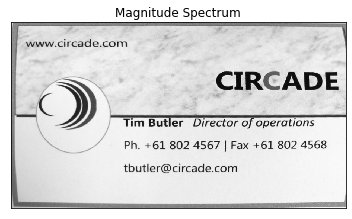

me EN
Hy-www.circade.com? .
whee Le e &
* gree

Tim Butler Director of operations

Ph. +61 802 4567 | Fax +61 802 4568

tbutler@circade.com


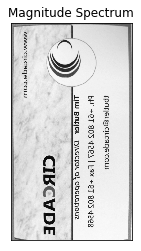

{PNSEL@ciucsqe'cow

bb’ +@T 805 ¥2e\ | ESX +eT 805 ¥2e8

LWW BOFIGL HUscpor Oo] obsragiovue


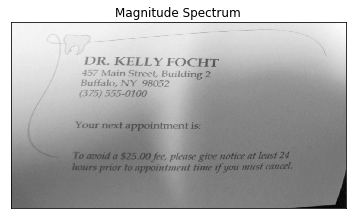

™

DR. KELLY FOCHT
457 Main Street, Building 2
Buffalo, NY 98052
(375) 555-0100

Your next appointment is:

To avoid a $25.00 fee, please give notice at least 24
hours prior fo appointment time if yor must cancel.


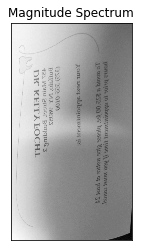

roma bison, yo abhourpnciy wins Dow wey cancey
LO LHOIY B VZVOO AGS hysues Bros wo pes wy youry 5g

Roni uext sbbompueur re:

(ye) 222-0100
BABSIO AX aed25
AA WS aftesr? BaTIqMe 5

pis KEPPA EOCHL

_7


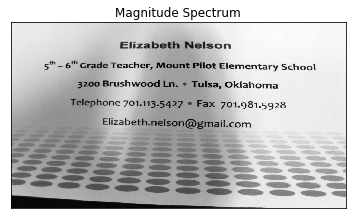

Elizabeth Nelson
5h 6" Grade Teacher, Mount Pilot Elementary School

3200 Brushwood Ln. * Tulsa, Oklahoma

Telephone 701.113.5427 © Fax 701.981.5928


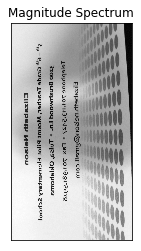

<> <> <>

> SS ae ee SS SS LSOOLVOLN OS S-
SS SS ae eS SO LVS LVA SS a
ye ee Se ee ee ee
eS SS ee eS LS SSS SS
SS ae ee ee SS SS SS ae
ie am Se Sm ie Mie TI ALS ENO AACE OTS ETM Se ae

Lsjebyous \ori3-2d55 e ESX Aoragredse
3300 BLNepMoog Fur e LAj23* OKISHOUWS
27 @,, CLEGG 16SCcCpeEL* wonug DOF EIGWUGUFSLA 2Cpoo}

Ellsspersy M16j20u


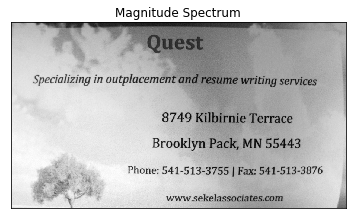

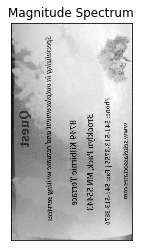

syoiszzocisice cou :

     
 

-3A22 lee eerarsame


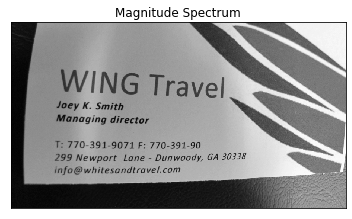

WING Travel

Joey K. Smith
Monaging director

  
  

T: 770-391-9071 F: 770-391-990
299 Newport Lane - Dunwoody, GA 30338
info@whitesandatravel.com


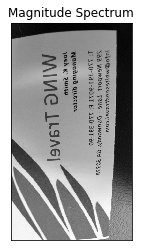

rhal

LOG Mpyszaugiansy cous
JII WVEMbOLE [AUS - HNUMOONN ey 3033g
4? \MO-39T-BOAT E+ \\0-30T-00

WoNGA WE qILEctoL

josh 1 Us

NING LLSAG|~


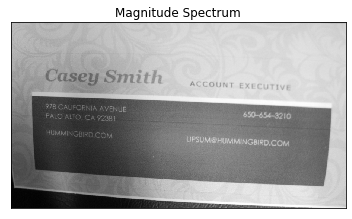

ciey Sete account EXECUTIVE

ca de a we

   

 

“Aeon


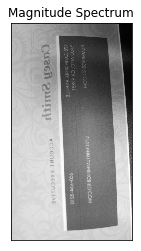

“mee ene

 

cconma EXECNLIAE


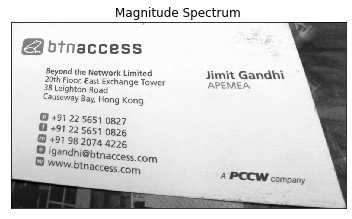

”

    
   
 
     
 

- @btnaccess
Beyond the Network Limited. Jimit Gandhi - ~

20th Floor, East Exchange Tower APEMEA
38 Leighton Road

Causeway Bay, Hong Kong

+ +9122 5651 0827
@ +9122 5651-0826 °
@ +91 98 2074 4226

igandhi@btnaccess,com
www.btnaccess.com


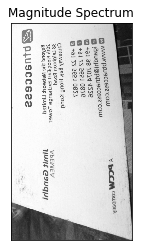

game
a yaauqpieprwsccee cow
( +9! 38 SOAt ISS
@+a1ss 2e2] 08Se.

» +91 SS 2e2! ogsi

canzemah poX Houd Koud _ - :

3g reldprou yosq
Sor Loot Es2k Excpsude JomeL
BeAOvG [US HEIMOLK PIWITE

pyusccsee

 

        

VbEWEV
WME @IUqGUI -


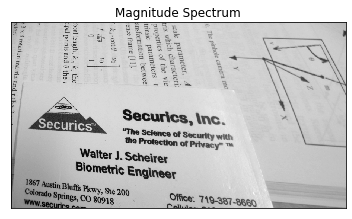

Securics, Inc.
Sreoa a
Walter 3. Schetrer oy
Biometric Engineer I

V4 ne
| See
1867 Austin Bluffs Pi

. See SSS ae
° Wy, Ste 200 Office: 119-287. “3 eee

‘lorado Springs, CO 80018 . aon | VSS8T-Beag

. WW)secunne eae


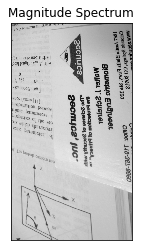

say bore suq Q SPF
woos] jouB Ip" Ke ABE
, oh
oT
Ya wh
s+ cor g? ao | s

teUCS jLouIg | nt :

  

on eohwo9e
rbiw yitwoee to eaneiee eit”

ar syapvitt lo robtsstor4 est

 

LriotlsW
na ohtemols

yationoe

iD

yon

 

gon sl a
81008 09

* de 12

again
ee OAT:

2
8


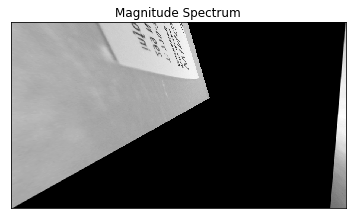

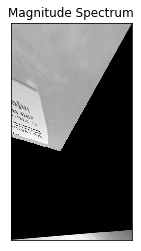

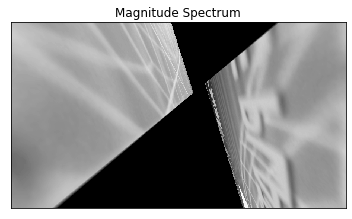

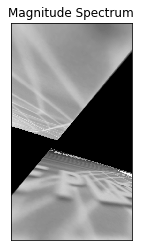

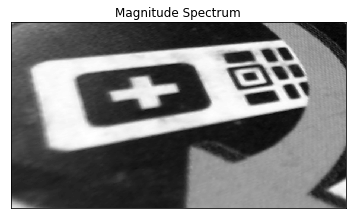

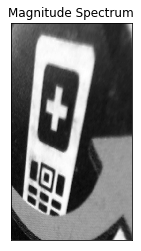

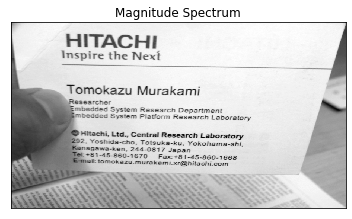

HITACHI

Inspire the Next

Tomokazu Murakami oo pw!
Researcher . -
‘Embedded System Research Department

  

mbedded System Platform Research Laboratory

4 OHitachi, Utd. Central Research Laboratory
292, Yoshida-cho, Totsuka-ku, Yokohama-shi,
- Kanagawa-ken, 244-0817 Japan
. ‘Tek +81-45-860-1670  Fax:+81-45-860-1668
cn €-maét tomokazu.murakami.xr@hitachi.com

ANS SRS. SSS SS
SRS ASE AS
AARAARNSR RASA NTS EAS


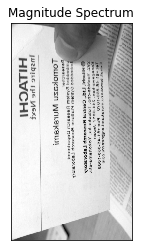

ia OS SS Kg TLS PAIS 4S 7 Po Fa
MEIC EEE GEE fEEED
ELEALE (LCE
ALES! pT
PPO IL LET a. JL LLO ELE

 
  

i
RS
*

S
Nie,
S
S

{rrp

pLiet
vet Pas
Ui fei lite
fies woe /OwOKSST-WNLsKIWYRAGpuscpy cows
. L6F 4gi-t2-Ge0-1eAO EMG*BI-WE-BeO-1ee8
Kaus8gmg-Kou* Stt-O8I4 qsbsu
. 59S" AO2BIQI-Cpo" Lorenks-KN* AoKopsws-2pr
\ QUHNPCHF Fig” CeUNSL WszesLep TSpoLsrorn
™ AS
Fuupegge 2Aziew PISHOUW HWeessicy TSsporsfo1k
EZwpeqqgeg cAzisw Wsecsicy psbsiweuy -
pezesicper

LOWOKSSN WNLSKSWI - a ec

 

    

 

ppabite fye Yexe

“~_HLIWCHI


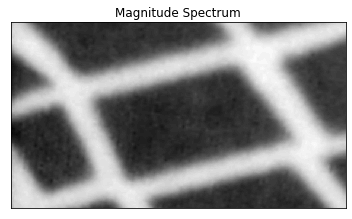

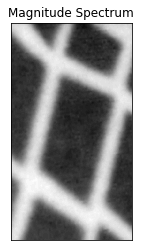

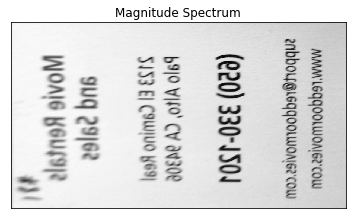

MMAVLECOOLWONIGe COW
anbborr@ueqqoorwontse cow .

(020) 330-1504

b9jo Vito" CV av300
3153 E] Colo Yoo|

Uy 2962
NOnIG [GUE]:
Hy


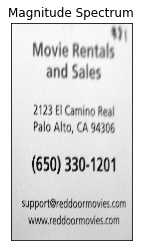

Movia Rentals
and Salas

2123 El Carino Real
Palo Alto, CA 94306

(650) 330-1201

support@reddoormovies.com °
~ Www.reddoormovies.com


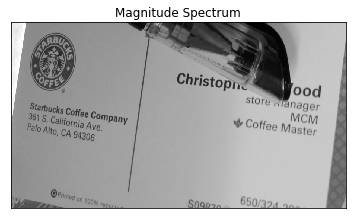

mo
ik

   

‘Ch ristopne dk.
Store-stianager

Starbucks Coffee Company
3615, Californig Ave,
9 Alto, C4 94306

 

650/204 an.
Snao-,
Le“ dt ee rr


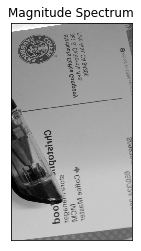

goio wo Cv 81308
Hatz COM
gustpnice couse cowsbauh


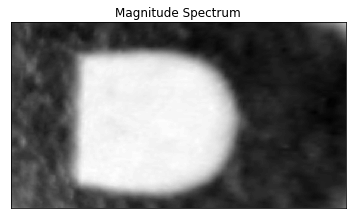

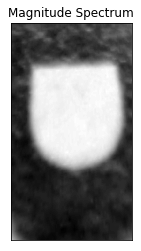

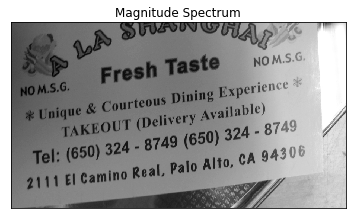

». a BS © UR py fo

Sp
NOMS.G. Fresh Taste NOMss..
5 Dining Experience x4

¢ Unique & Courtcou
TAKEOUT (Delivery Available)
Tel: (650) 324 - 8749 (650) 324-8749 | J.

a1il el Camino Rea


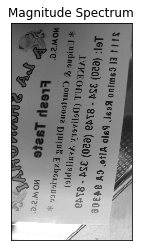

S11 El esuyuo K69l" Ayo Vito

owee Eleay ISege re


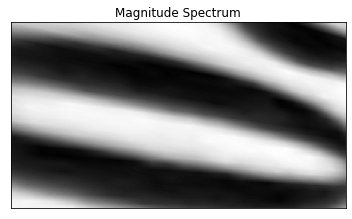

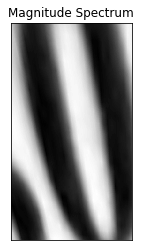

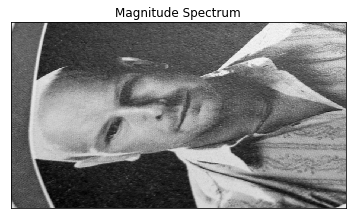

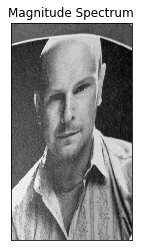

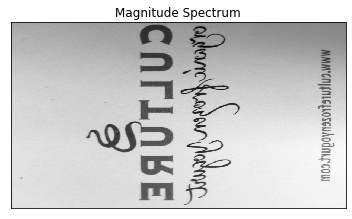

AMM'CHIEMLGLLOSeUAOdALE cow

Soret Surg
CFLABE

%


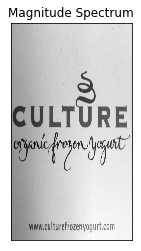

¢ uti E

www.culturefrozenyogurt.com


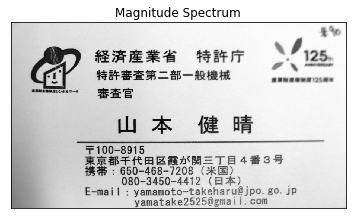

Oo |

te 4%
JS) aman wie \ F125,

Ba AMA Nanas

eanseuarrner—> Ete :

i AR Oe OH

eee eel e a
ERT HR meat = TH 4G35
$EH3 : 650- to 7208 (35) -
080-3450-4412 (HA)
E-mail : yamamoto-takeharu@ jpo. go. jp
yamatake2525@gmai |. com


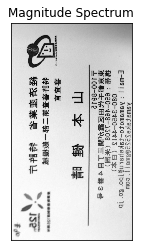

ASUS FSIKES PS PGEWS! |* cow
E-ws! | = ASWSwOfo-FsKeysiNng1bo" Bo: 1b
O080-3920-WWIS (He)
Bee e20-ves-1508 (KEI) . :
spe SE te ae ee = 1 Y838
100-8812

 

supsenensees—>

oa

SRE HHL Aye

Te @ we

BES

_. _ Benuanasiue
BEES a)

$go

|


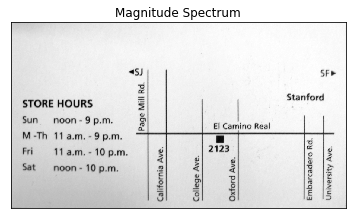

«

uw
eo

SFe

    

STORE HOURS . ‘Stanford
sun, noon-9p.m.
M-Th 11a.m.-9 p.m.
Fri 11. a.m.- 10 p.m.
Sat noon - 10 p.m.

» El Camino Real”

    

Page Mill Rd.

   
  

         

i

Embarcadero Rd.
University Ave.

 

California Ave.
College Ave.
Oxford Ave.


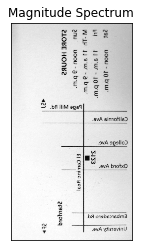

aot uoou - 19 b'w:
EU 4g sw = yg bw
Welp Jy ow +a bu
enu’ =voou-gbu:
2LOBE HONwe

-oVA spalloD
2vA biohkO

        

-9vA simotils>

 

.ovA ytiztsvinU

    

-bA orsbensdm3

     

zsaujorq

-bAIIIM 9p64

<2) ke


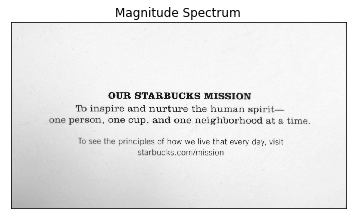

OUR STARBUCKS MISSION
To inspire and nurture the human spirit—
one person, one cup, and one; neighborhood at a time.

To see the principles of how we live that every day, visit
starbucks.comi/mission


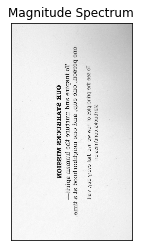

aysupnexecommieziou .
10 266 [Ue buwclbjs2 of POM ME JIAG {UST GAGLA GOA’ AlztE
oue berzou’ ove cab’ sug ove: peyBppoLpoog sf s pe"
Io Wwebine sug unLpnie spe powesy ebyuip—
OOF 2LVBBNCKe Wile2Ion


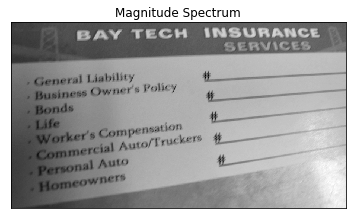

» General Liability :
, Business Owner's Policy tL

» Bonds

+ Life
, Worker's Compensation
.Com mercial Avtof yruckers

‘ personal Auto

. Homeowner?

nee


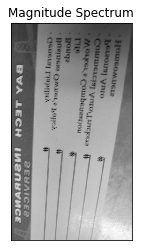

“} 1OWMCOMUELY
*b6wOug Varo
‘Comme SLE} Varo) MNGKGLe
* MOK Combsnesnoy

“PNG

* Bouga

* Pe iGee Graver DYONEA
> O6N6L) PreprEd

  

[GRA NECHMILASHEVICE,


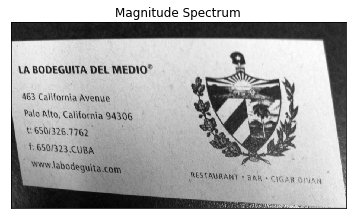

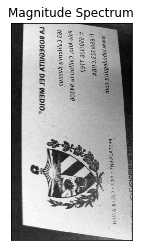

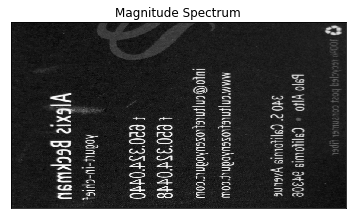

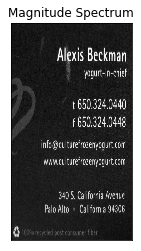

Bivessstonseenwiceity


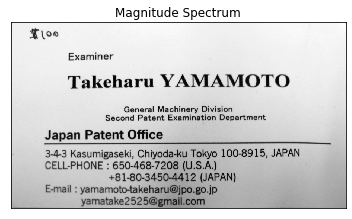

Too

Examiner

Takeharu YAMAMOTO"

General Machinery Division
Second Patent Examination Department
aoe

Japan Patent Office

- 3-4-3 Kasumigaseki, Chiyoda-ku Tokyo 100-8915, JAPAN

CELL-PHONE : 650-468-7208 (U.S.A.)
+81-80-3450-4412 (JAPAN).

E-mail : yamamoto-takeharu@jpo.go.|Jp

yamatake2525@gmail.com


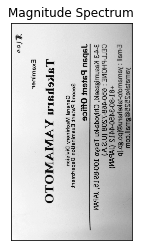

ASWWISSKES OS P@EwS)/'cow
E-Lusl  ASLUSLUOSO-PSKEPSLN@]O0°Eo"]b

+8I-80-30200TIS (bv): .
CEIT-bHOUE : e20-te8-\S08 (n'e'v’) ,
313 KSeMWIEs2ex]’ CHIAOGS-KN LoKAO TOO-gaT2" aVbW
ysbsu _sreur OLCcE

gecoug Lafeur Exswuszou Debsisweus
GeUuGhe] FWSCHILELA DIAIZION

LIK6BILA XVIALVINO.LO

 

Exswiven

Hfoo


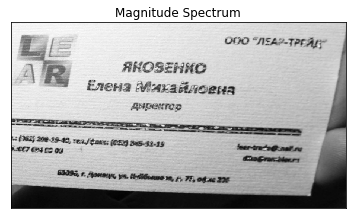

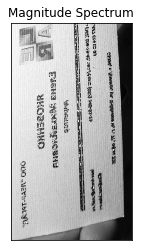

ы аее ененеечнЕЙ
—


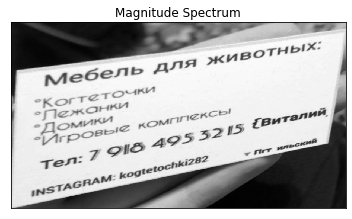

о
домое

2 И5

 

двителий-Г&
:


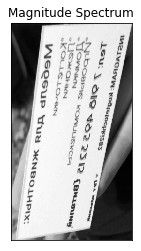

- /_\//_!Ф!Ю‘:Ф”_и иа -


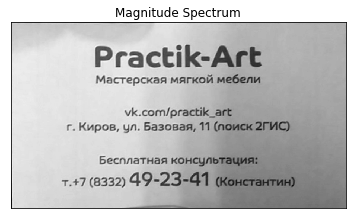

Ргас К-АгЕ

Мастерская 'мягкой мебели

УК.согт/ргаснК_аге
г. Киров, ул. Базовая, 11 (поиск 2ГИС)

Бесплатная консультация:

т.#7.(8332) 49-23"41 (Константин)


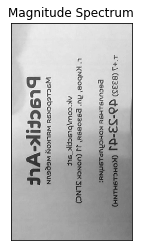

++3 (8335) -- (Конекенамн)

ресичеаняч консйиРАЯйМЫ:

* Кмбов' А' рэзовам' 14 (чомск 5 С)
лк`сошщ\бНВЕтК” 9ер

ЕШРРФСПХШЦ.ЁЦЕОР_ мбеБиМ

БчЭСЕК- ЧЕ


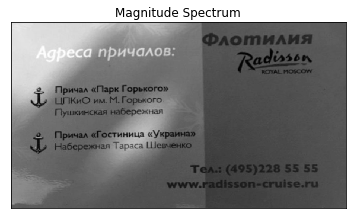

\
Флотилия

АЕраво ‘ даа':'дм_ц

КОтАБМО5СОМГ.

 

Э.. Причал «Парк Горького» %
ЦПКИФ им. М. Горького. -,
Гушкинская набережная / ^-..: і

!

Э, — Причал «Гостиница «Украин:и›
Набережная Тараса Шевченко

Ц

ТеА.. (495)228 55 55
УУУГУ. г"’к!іззоп -сгоБе.гц


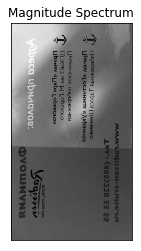

.Мкм‚.\.г.……‚. »»Зг._д_ммо: сьпугб*ып

З ° т‹ (чав)з58 2 вг

жн.. нзесбежнеы ._‚штщп…._ ГПеваенко …
о’ ЦБназу «осчНния ……›.„пцт_:„ё

1 Мпкмнскун нзосБежнм ` В _
ПНОКВО муг р оБекого: — —°
9° ЦБназУ «ЦЗБК | оБРКОЦО» …

аиеы \ ‚ ш„и‹Щ‹_т‚таы\
КО \0 ОВ;
\АуевО ОКЫКОВЕВ ФМОНИМУМА

оуИ Н |


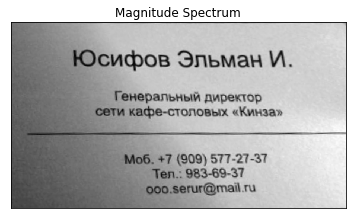

Юсифов Эльман .

° Генеральный директор
сети кафе—стоповых «Кииза» -

 

°` ‘Моб. +7 (909) 577-27-37 ля
° Тел.: 983-69-37 ;
-- ©90. зешг@ша\\ш


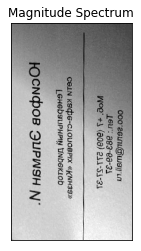

° ебо’ мшБ_‚@‚ЕЁБ .
- - 16и: 983-00-3А -_—°
‘ _гою +.‚ з…ё ю.:.и.‚.&

 

8__2 хщд…т.оьосошъ_х аё‹хыш„„ @
_.……:шсщ:_„хзг Умбек1оЬ

— юсмфов ЭиРИФН `


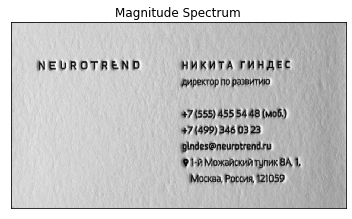

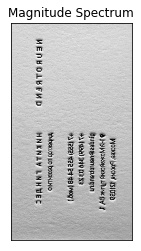

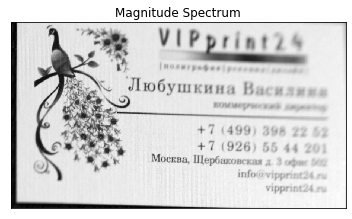

9е МЕР рг! л! 7
®
: \& 1"0"7›-0-0„:„„. 6а л.ч 7

Любушкшш Висиля:

и КОМ метрыя вю В в аыа ,
ОИ О7 (499) 398 22 57

}+7 (926) 55 44 201

осква, Щербаковская д. 3 от 12

‚ ИО иврртим24 гы

* Мрроо124 и


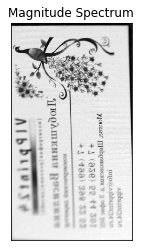

; МЪЫЗодЫлл
идо@ МБЫщорул
еве’ [сБочковских 3г 3 сфиб ох
+ (950) 92 14 50
оА (чд9) 308 5% 2х

кол ме
_Щ…оюу::„::д рисизние

_._в.-.т._о::..‚‹о. *ч . ®

  

    

ааы’и Уа Лоень ой


In [7]:
index=0
for fn in images[:]:
 
    ffn = directory + '/'+fn # имя файла, который будем анализировать
    img = cv.imread(ffn,0)
    thresh4 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_MEAN_C,cv.THRESH_BINARY,11,5)
    kernel = np.ones((1,1),np.uint8)
    thresh4 = cv.morphologyEx(thresh4, cv.MORPH_CLOSE, kernel, iterations = 2)
    thresh4 = cv.morphologyEx(thresh4, cv.MORPH_OPEN, kernel, iterations = 1)
    
    
    plt.subplot(),plt.imshow(img, cmap = 'gray')
    plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
    plt.show()
    if index < 88:
        language = 'eng'
    else:
        language = 'rus'
    print(pytesseract.image_to_string(thresh4 , lang = language))
    index+=1